# Inference for neuronal data example 

Algorithms included:

- Kalman
- PMMH-50 (CPMMH w N=50 and rho = 0)
- PMMH-10 (CPMMH w N=10 and rho = 0)
- PMMH-8,6,4,2,1
- CPPMH-10 (CPMMH w N = 10 and rho = 0.999)
- CPPMH-1 
- CPPMH-1 bootstrap


### Setput 

Set correct working directory. 

In [1]:
pwd()

"/home/samuel/Documents/projects/cpmmh for sdemems/code/analyses/notebooks"

In [2]:
cd("..") # set correct working directory 
cd("..") 
pwd() # the path should go to the folder with the .git file 

"/home/samuel/Documents/projects/cpmmh for sdemems/code"

Load data and functions 

In [3]:
using Pkg
using Pkg
using PyCall 
PyDict(pyimport("matplotlib")["rcParams"])["ps.useafm"] = [true]
PyDict(pyimport("matplotlib")["rcParams"])["pdf.use14corefonts"] = [true]
PyDict(pyimport("matplotlib")["rcParams"])["text.usetex"] = [true]
using PyPlot 
using LinearAlgebra
using DataFrames
using KernelDensity  
using LaTeXStrings
using Distributions

save_plots = true 
save_data = false 
run_algorithms = true 

# load functions
include(pwd()*"/src/SDEMEM OU neuron data/ou_sdemem.jl")
#include(pwd()*"/src/SDEMEM OU neuron data/mcmc.jl")


M_subjects = 100

seed = 100 # parse(Int,ARGS[1])

y,prior_parameters_η,prior_parameters_σ_ϵ = set_up(M_subjects,seed); 



┌ Warning: `getindex(o::PyObject, s::AbstractString)` is deprecated in favor of dot overloading (`getproperty`) so elements should now be accessed as e.g. `o."s"` instead of `o["s"]`.
│   caller = top-level scope at In[3]:4
└ @ Core In[3]:4
┌ Warning: `getindex(o::PyObject, s::AbstractString)` is deprecated in favor of dot overloading (`getproperty`) so elements should now be accessed as e.g. `o."s"` instead of `o["s"]`.
│   caller = top-level scope at In[3]:5
└ @ Core In[3]:5
┌ Warning: `getindex(o::PyObject, s::AbstractString)` is deprecated in favor of dot overloading (`getproperty`) so elements should now be accessed as e.g. `o."s"` instead of `o["s"]`.
│   caller = top-level scope at In[3]:6
└ @ Core In[3]:6


Plot latant process (left) and observed process (rigth).

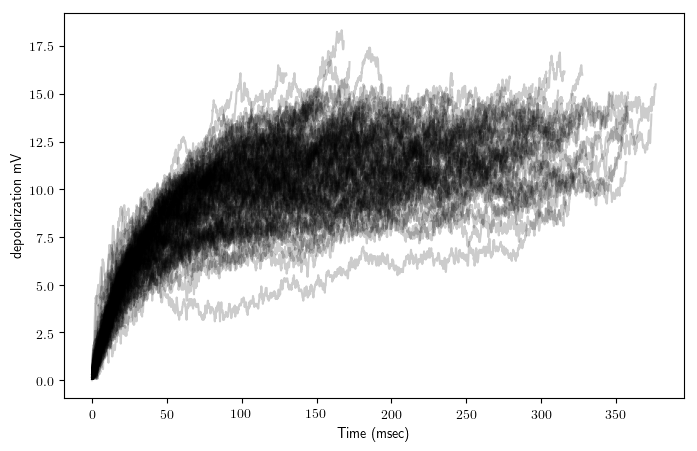

Process(`pdftops -eps figures/neuron_data_new.pdf figures/neuron_data_new.eps`, ProcessExited(0))

In [4]:
# Plot data (this plot should be similar to Fig 3 in the paper)
PyPlot.figure(figsize=(8,5))
for i in 1:M_subjects
    PyPlot.plot(y[i].mSec, y[i].mV, "k", alpha = 0.2)
end
PyPlot.xlabel("Time (msec)")
PyPlot.ylabel("depolarization mV")


if save_plots
    PyPlot.savefig("figures/neuron_data_new.pdf", format="pdf", dpi=1000)
    run(`pdftops -eps figures/neuron_data_new.pdf figures/neuron_data_new.eps`)
end 

In [8]:
save_plots

true

### Algorithm settings 

In [5]:
R = 100000 #100000 #15000 #10000
burn_in = 20000

20000

Setting for trace plots.

In [6]:
plot_from_start = true # set to true to plot chains from first iteration
burn_in_trace = 1

if !plot_from_start
    burn_in_trace = burn_in
end

### Run/Load Gibbs sampler with Kalman filter 

In [7]:
job = string(M_subjects) 

"100"

In [8]:
# load stored results
chain_σ_ϵ_kalman = Matrix(CSV.read("data/SDEMEM OU neuron data/kalman/chain_sigma_epsilon_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_σ_ϵ_kalman = Matrix(chain_σ_ϵ_kalman')
chain_η_kalman = Matrix(CSV.read("data/SDEMEM OU neuron data/kalman/chain_eta_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_η_kalman = Matrix(chain_η_kalman')
chain_ϕ_export = Matrix(CSV.read("data/SDEMEM OU neuron data/kalman/chain_phi_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_ϕ_export = Matrix(chain_ϕ_export')
chain_ϕ_kalman = zeros(M_subjects,3,R)
idx = 0 
for m = 1:M_subjects
    for j = 1:3
        idx = idx + 1
        chain_ϕ_kalman[m,j,:] = chain_ϕ_export[idx,:]
    end 
end 

simdata_kalman = Matrix(CSV.read("data/SDEMEM OU neuron data/kalman/sim_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
println(simdata_kalman[1])
println(simdata_kalman[2])
println(simdata_kalman[3])
println(simdata_kalman[4])


loglik_data = Matrix(CSV.read("data/SDEMEM OU neuron data/kalman/loglik_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto));



┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


3350.458591662
0.2498218
0.25226
1.0


┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


Create start value and cov for comp analyses 

In [9]:
posterior_mean_sigma_epsilon_and_phi = [mean(chain_σ_ϵ_kalman[burn_in:end]) 0 0;
                         mean(chain_ϕ_kalman[:,:,burn_in:end], dims=3)]

posterior_mean_sigma_epsilon_and_phi_df = DataFrame(posterior_mean_sigma_epsilon_and_phi[:,:,1])

CSV.write("data/SDEMEM OU neuron data/posterior_mean_sigma_epsilon_and_phi.csv", posterior_mean_sigma_epsilon_and_phi_df)

posterior_mean_eta_df = DataFrame(mean(chain_η_kalman[:,burn_in:end], dims=2))

CSV.write("data/SDEMEM OU neuron data/posterior_mean_eta.csv", posterior_mean_eta_df)

cov_ms = zeros(1+M_subjects,3*3)
cov_ms[1,1] = cov(chain_σ_ϵ_kalman[burn_in:end])

for i = 1:M_subjects
    cov_ms[i+1,:] = cov(chain_ϕ_kalman[i,:,burn_in:end], dims=2)[:]
end


cov_df = DataFrame(cov_ms)

CSV.write("data/SDEMEM OU neuron data/posterior_cov_ms.csv", DataFrame(cov_df))



show(posterior_mean_sigma_epsilon_and_phi_df)

show(posterior_mean_eta_df)

show(cov_df)

101×3 DataFrame
│ Row │ x1       │ x2        │ x3        │
│     │ Float64  │ Float64   │ Float64   │
├─────┼──────────┼───────────┼───────────┤
│ 1   │ -6.94577 │ 0.0       │ 0.0       │
│ 2   │ -3.34366 │ -0.959539 │ -0.736368 │
│ 3   │ -3.40472 │ -0.865698 │ -0.883242 │
│ 4   │ -3.55237 │ -0.908416 │ -0.900969 │
│ 5   │ -3.49841 │ -0.91715  │ -0.941251 │
│ 6   │ -3.57337 │ -0.889792 │ -1.01909  │
│ 7   │ -3.27495 │ -0.951542 │ -0.832963 │
│ 8   │ -3.21382 │ -1.03902  │ -0.811826 │
│ 9   │ -3.50266 │ -0.918569 │ -0.904454 │
│ 10  │ -3.45946 │ -0.895137 │ -0.875453 │
⋮
│ 91  │ -3.36469 │ -0.888538 │ -0.787573 │
│ 92  │ -3.35094 │ -0.939067 │ -0.880009 │
│ 93  │ -3.20629 │ -0.736341 │ -0.888029 │
│ 94  │ -3.36849 │ -0.840904 │ -0.670912 │
│ 95  │ -3.23611 │ -1.03618  │ -0.8952   │
│ 96  │ -3.40973 │ -1.07738  │ -0.865841 │
│ 97  │ -3.2653  │ -0.919997 │ -0.843767 │
│ 98  │ -3.36705 │ -1.08701  │ -0.820635 │
│ 99  │ -3.23584 │ -0.845877 │ -0.894956 │
│ 100 │ -3.37304 │ -1.02477  │ -0.79

In [10]:
cov(chain_ϕ_kalman[1,:,burn_in:end], dims=2)

3×3 Array{Float64,2}:
 0.0398038    0.0191724   0.000201962
 0.0191724    0.0230739   0.00013297 
 0.000201962  0.00013297  0.000802965

Print loglik for each iterations

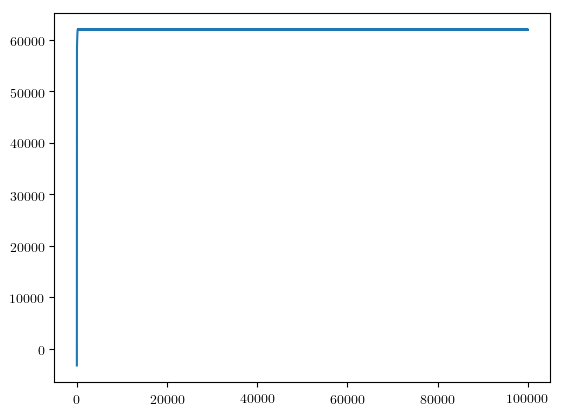

1-element Array{PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f4a40107ef0>

In [8]:
PyPlot.figure()
PyPlot.plot(loglik_data)

Chain for $\sigma_{\epsilon}$. Blue line trace, black dashed line true parameter value.

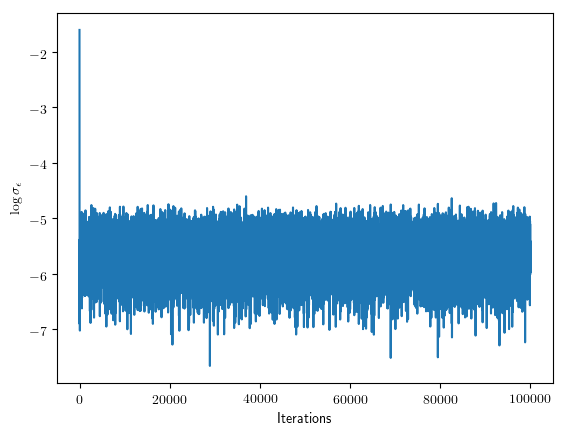

In [9]:
PyPlot.figure()
PyPlot.plot(chain_σ_ϵ_kalman[1,burn_in_trace:end])
PyPlot.ylabel(L"\log \sigma_{\epsilon}")
PyPlot.xlabel("Iterations");

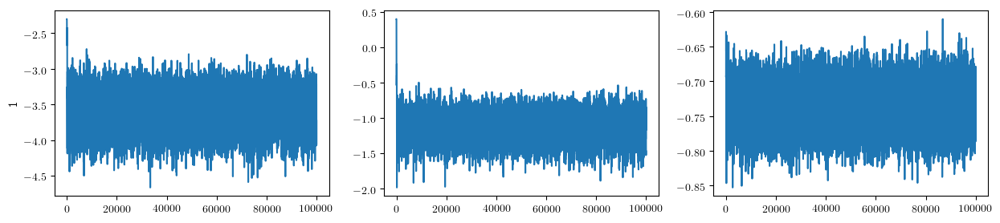

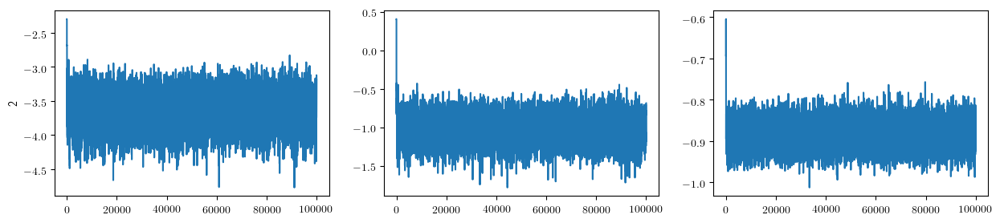

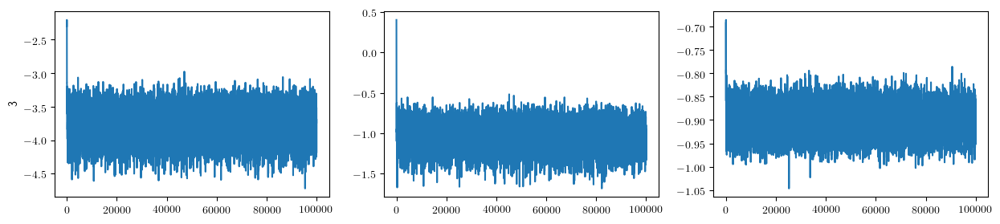

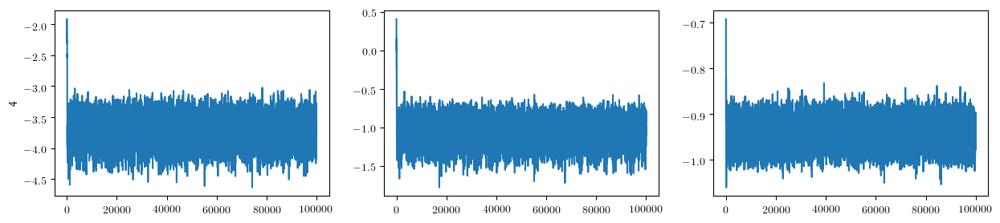

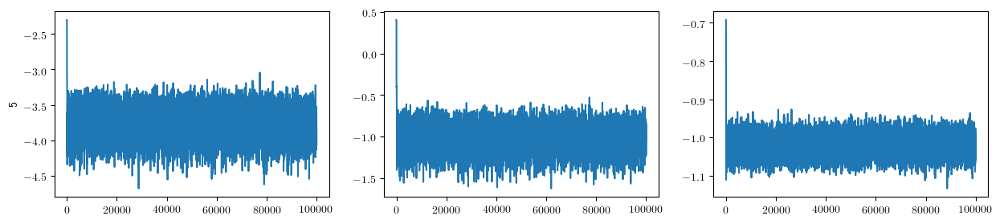

...

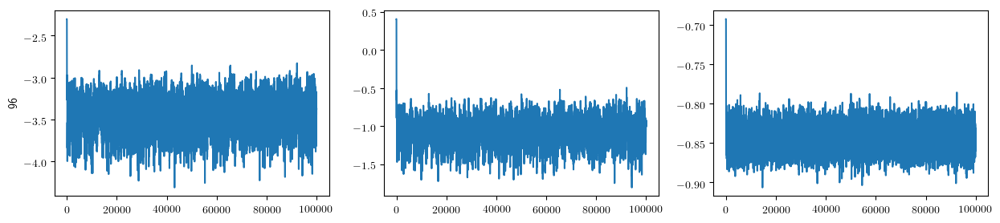

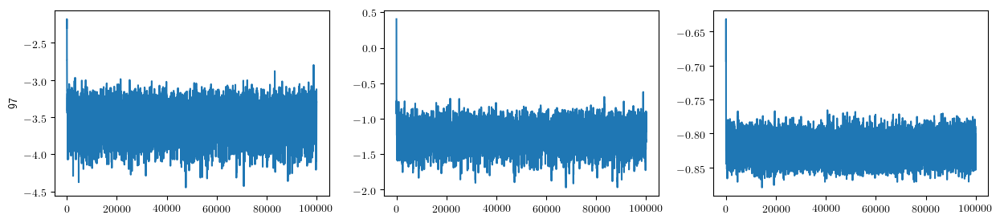

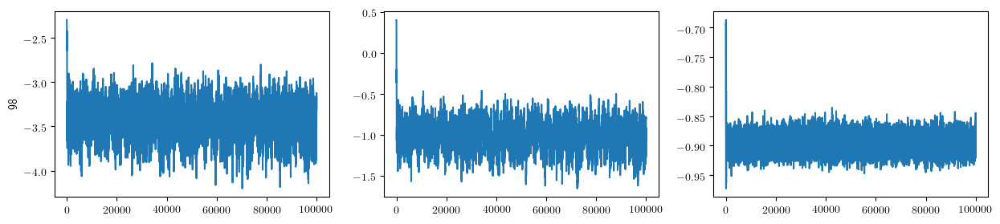

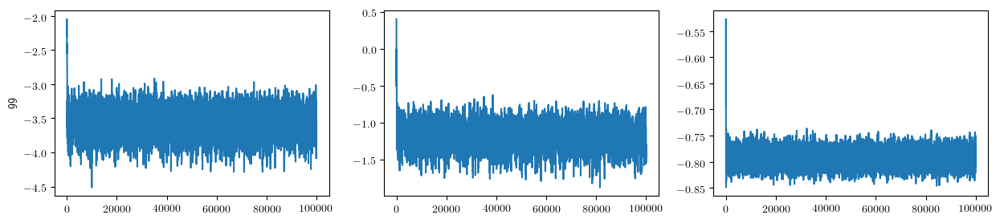

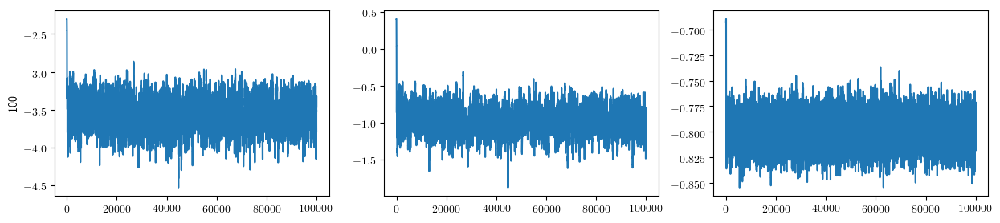

In [10]:
for i in 1:M_subjects
    
    PyPlot.figure(figsize=(15,3))
    
    ax1 = PyPlot.subplot(1,3,1)

    PyPlot.plot(chain_ϕ_kalman[i,1,burn_in_trace:end])
    PyPlot.ylabel(i)

    ax1 = PyPlot.subplot(1,3,2)
    PyPlot.plot(chain_ϕ_kalman[i,2,burn_in_trace:end])

    ax1 = PyPlot.subplot(1,3,3)
    PyPlot.plot(chain_ϕ_kalman[i,3,burn_in_trace:end])
end 

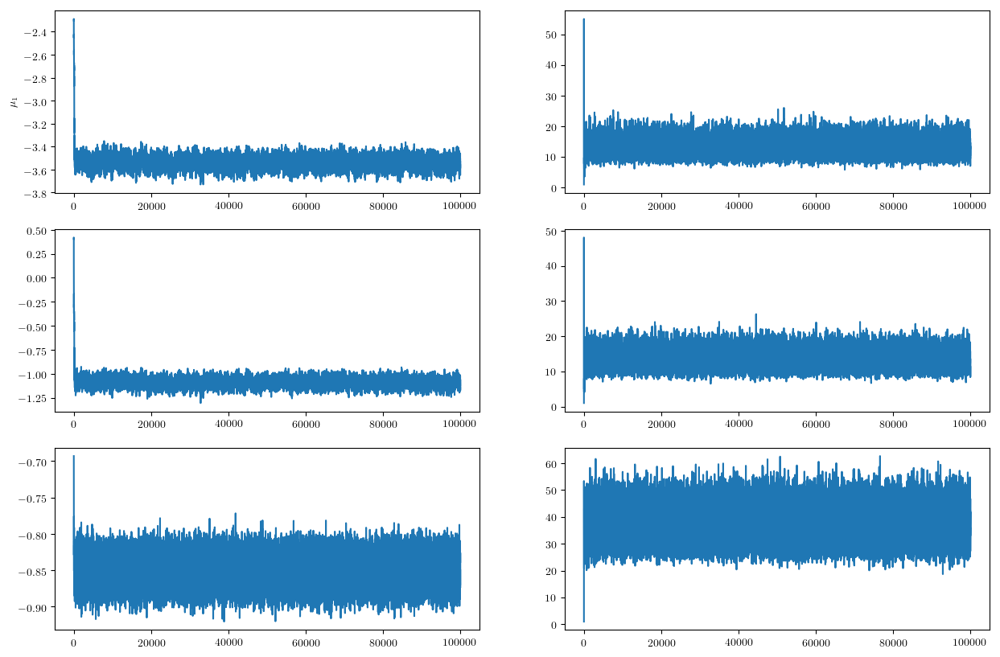

In [11]:
PyPlot.figure(figsize=(15,10))

ax1 = PyPlot.subplot(3,2,1)
PyPlot.plot(chain_η_kalman[1,burn_in_trace:end])
PyPlot.ylabel(L"\mu_1")

ax1 = PyPlot.subplot(3,2,3)
PyPlot.plot(chain_η_kalman[2,burn_in_trace:end])
#PyPlot.ylabel(L"\mu_2")

ax1 = PyPlot.subplot(3,2,5)
PyPlot.plot(chain_η_kalman[3,burn_in_trace:end])
#PyPlot.ylabel(L"\mu_3")
#PyPlot.xlabel("Iterations");

ax1 = PyPlot.subplot(3,2,2)
PyPlot.plot(chain_η_kalman[4,burn_in_trace:end])
#PyPlot.ylabel(L"\tau_1")

ax1 = PyPlot.subplot(3,2,4)
PyPlot.plot(chain_η_kalman[5,burn_in_trace:end])
#PyPlot.ylabel(L"\tau_2")

ax1 = PyPlot.subplot(3,2,6)
PyPlot.plot(chain_η_kalman[6,burn_in_trace:end])
#PyPlot.ylabel(L"\tau_3")
#PyPlot.xlabel("Iterations");

### Run/Load Gibbs with PMMH - bridge 50

In [12]:
ρ = 0.0
nbr_particles = 1

job = string(M_subjects)*"_"*string(ρ)*"_"*string(nbr_particles)*"_bridge"


"100_0.0_1_bridge"

In [13]:
# load stored results
chain_σ_ϵ_pmmh = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_sigma_epsilon_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_σ_ϵ_pmmh = Matrix(chain_σ_ϵ_pmmh')
chain_η_pmmh = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_eta_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_η_pmmh = Matrix(chain_η_pmmh')
chain_ϕ_export_pmmh = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_phi_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_ϕ_export_pmmh = Matrix(chain_ϕ_export_pmmh')
chain_ϕ_pmmh = zeros(M_subjects,3,R)
idx = 0 
for m = 1:M_subjects
    for j = 1:3
        idx = idx + 1
        chain_ϕ_pmmh[m,j,:] = chain_ϕ_export_pmmh[idx,:]
    end 
end 


simdata_pmmh = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/sim_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
println(simdata_pmmh[1])
println(simdata_pmmh[2])
println(simdata_pmmh[3])
println(simdata_pmmh[4])

loglik_data = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/loglik_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto));



┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


28861.942924399
0.2415784
0.24721
1.0


┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


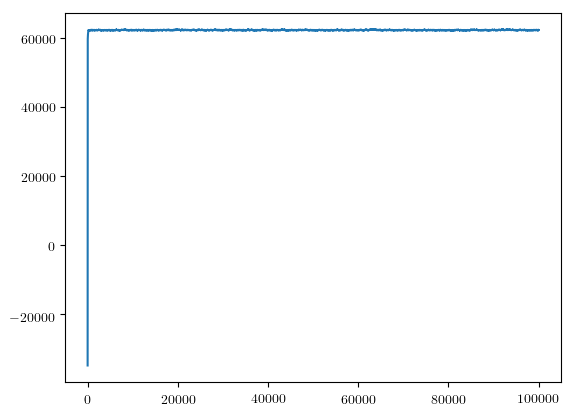

1-element Array{PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f49ea510320>

In [14]:
PyPlot.figure()
PyPlot.plot(loglik_data)

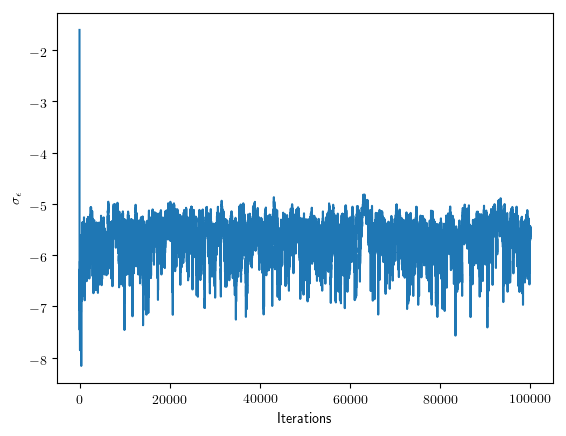

In [14]:
PyPlot.figure()
PyPlot.plot(chain_σ_ϵ_pmmh[1,burn_in_trace:end])
PyPlot.ylabel(L"\sigma_{\epsilon}")
PyPlot.xlabel("Iterations");

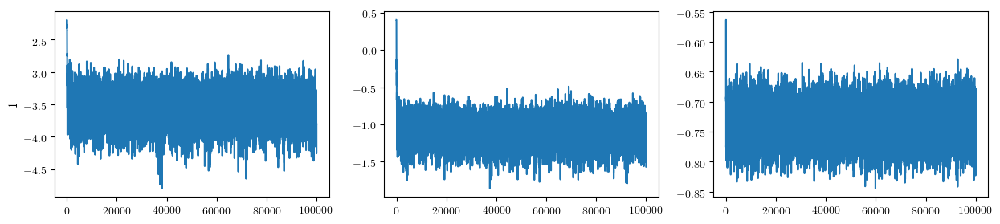

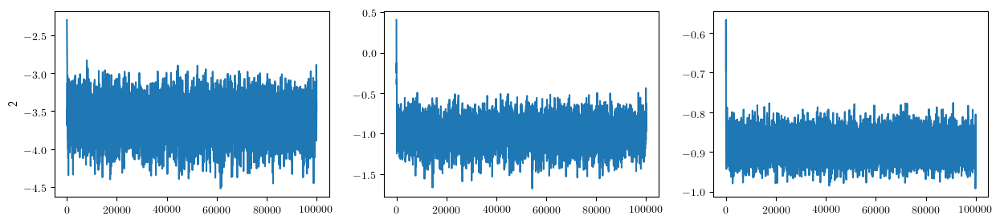

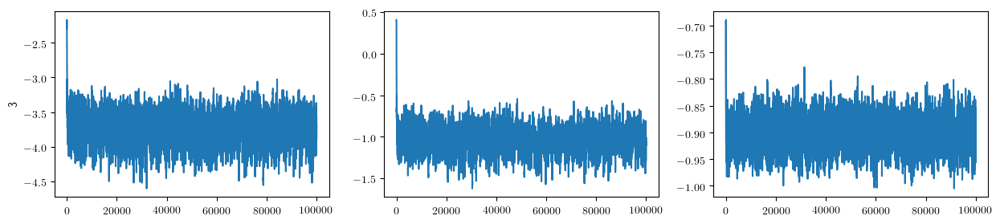

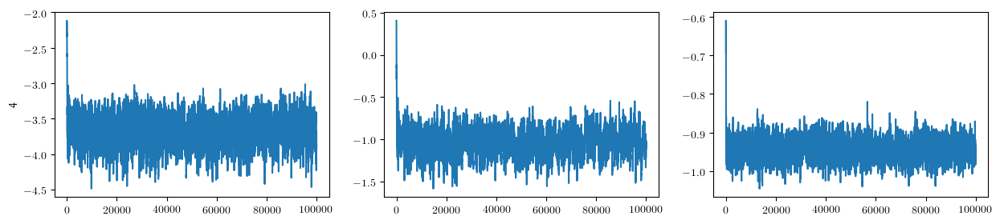

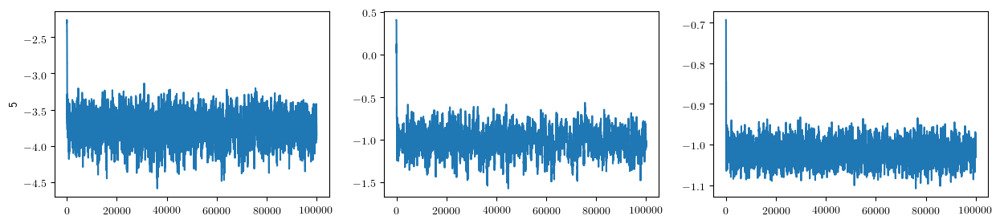

...

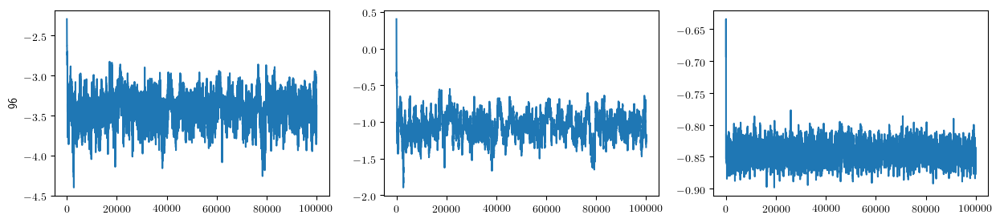

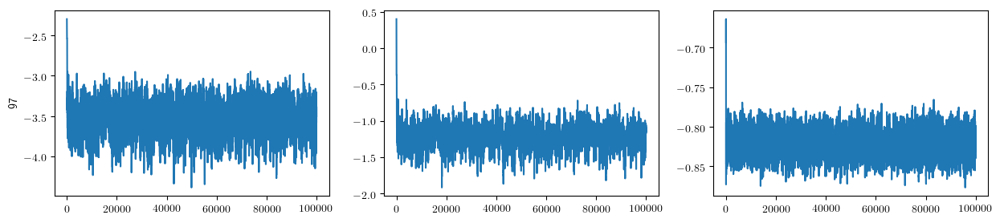

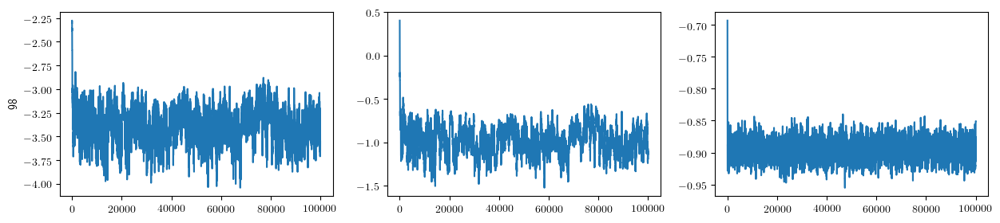

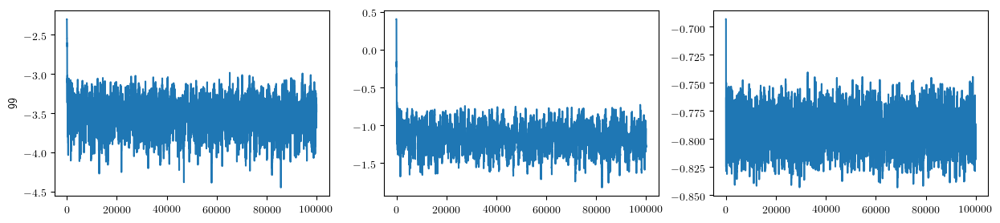

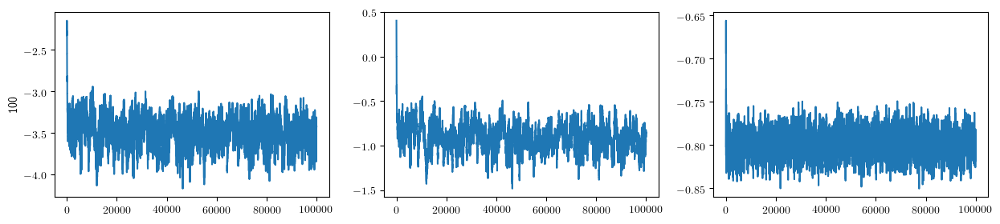

In [15]:
for i in 1:M_subjects
    
    PyPlot.figure(figsize=(15,3))

    
    ax1 = PyPlot.subplot(1,3,1)

    PyPlot.plot(chain_ϕ_pmmh[i,1,burn_in_trace:end])
    PyPlot.ylabel(i)
    
    ax1 = PyPlot.subplot(1,3,2)
    PyPlot.plot(chain_ϕ_pmmh[i,2,burn_in_trace:end])

    ax1 = PyPlot.subplot(1,3,3)
    PyPlot.plot(chain_ϕ_pmmh[i,3,burn_in_trace:end])
end 

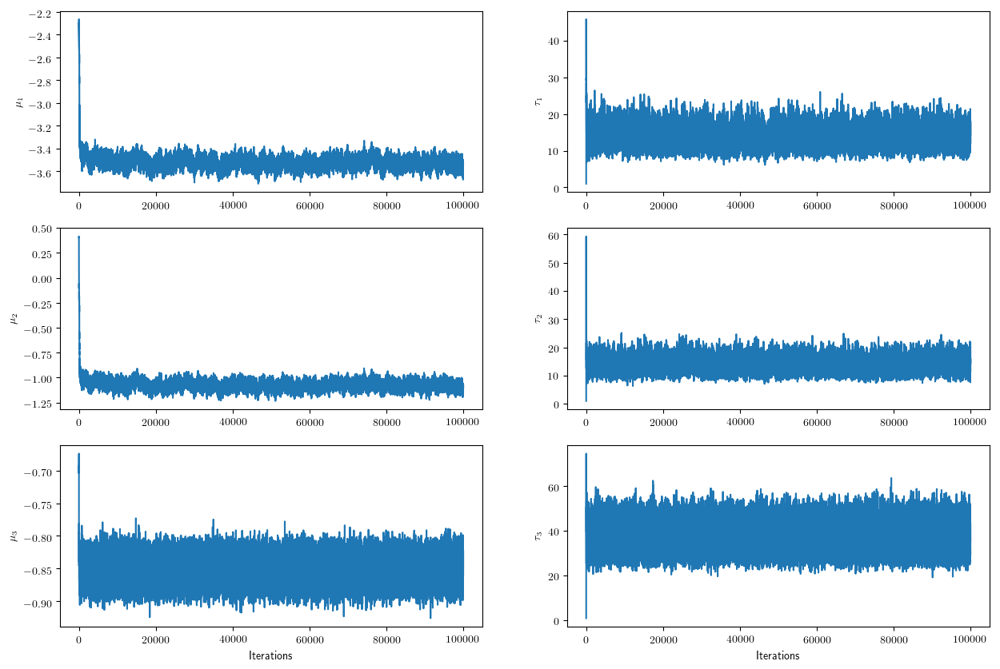

In [16]:
PyPlot.figure(figsize=(15,10))

ax1 = PyPlot.subplot(3,2,1)
PyPlot.plot(chain_η_pmmh[1,burn_in_trace:end])
PyPlot.ylabel(L"\mu_1")

ax1 = PyPlot.subplot(3,2,3)
PyPlot.plot(chain_η_pmmh[2,burn_in_trace:end])
PyPlot.ylabel(L"\mu_2")

ax1 = PyPlot.subplot(3,2,5)
PyPlot.plot(chain_η_pmmh[3,burn_in_trace:end])
PyPlot.ylabel(L"\mu_3")
PyPlot.xlabel("Iterations");

ax1 = PyPlot.subplot(3,2,2)
PyPlot.plot(chain_η_pmmh[4,burn_in_trace:end])
PyPlot.ylabel(L"\tau_1")

ax1 = PyPlot.subplot(3,2,4)
PyPlot.plot(chain_η_pmmh[5,burn_in_trace:end])
PyPlot.ylabel(L"\tau_2")

ax1 = PyPlot.subplot(3,2,6)
PyPlot.plot(chain_η_pmmh[6,burn_in_trace:end])
PyPlot.ylabel(L"\tau_3")
PyPlot.xlabel("Iterations");

## CPMMH - 0.999 

In [17]:
ρ = 0.999
nbr_particles = 1

job = string(M_subjects)*"_"*string(ρ)*"_"*string(nbr_particles)*"_bridge"


"100_0.999_1_bridge"

In [18]:
chain_σ_ϵ_cpmmh = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_sigma_epsilon_"*string(seed)*"_"*job*".csv",allowmissing=:auto))

chain_σ_ϵ_cpmmh = Matrix(chain_σ_ϵ_cpmmh')
chain_η_cpmmh = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_eta_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_η_cpmmh = Matrix(chain_η_cpmmh')
chain_ϕ_export_cpmmh = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_phi_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_ϕ_export_cpmmh = Matrix(chain_ϕ_export_cpmmh')
chain_ϕ_cpmmh = zeros(M_subjects,3,R)

idx = 0 
for m = 1:M_subjects
    for j = 1:3
        idx = idx + 1
        chain_ϕ_cpmmh[m,j,:] = chain_ϕ_export_cpmmh[idx,:]
    end 
end 


simdata_cpmmh = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/sim_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
println(simdata_cpmmh[1])
println(simdata_cpmmh[2])
println(simdata_cpmmh[3])
println(simdata_cpmmh[4])

loglik_data = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/loglik_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto));





┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


39329.099799714
0.2494622
0.24812
1.0


┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


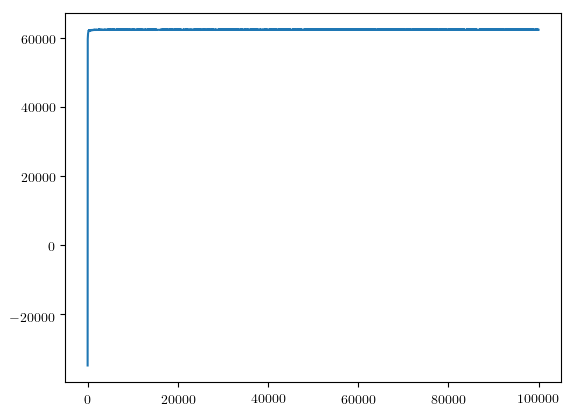

1-element Array{PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f49fe6d1860>

In [20]:
PyPlot.figure()
PyPlot.plot(loglik_data)

In [42]:
var(loglik_data[500:end])

345.9418350483738

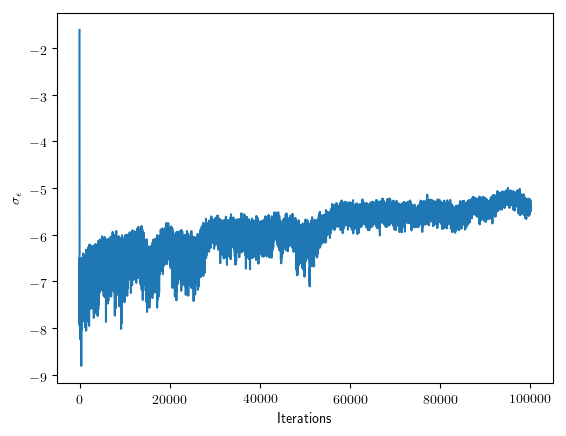

In [19]:
PyPlot.figure()
PyPlot.plot(chain_σ_ϵ_cpmmh[1,burn_in_trace:end])
PyPlot.ylabel(L"\sigma_{\epsilon}")
PyPlot.xlabel("Iterations");

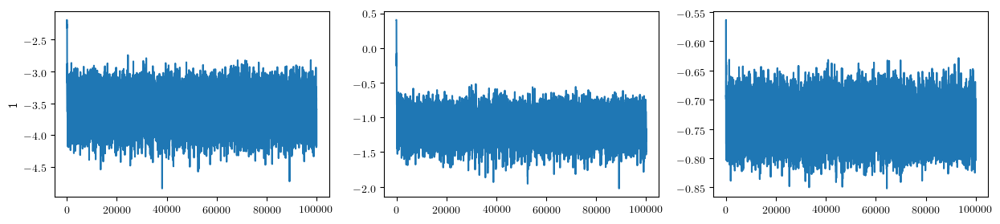

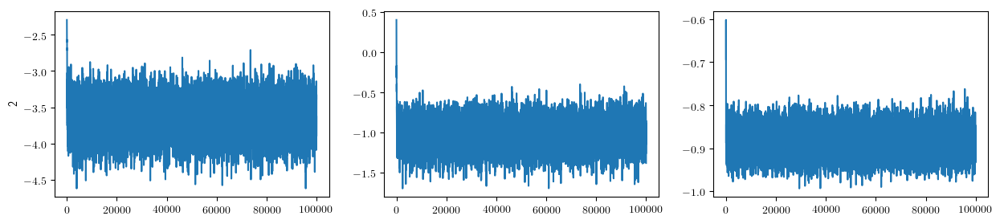

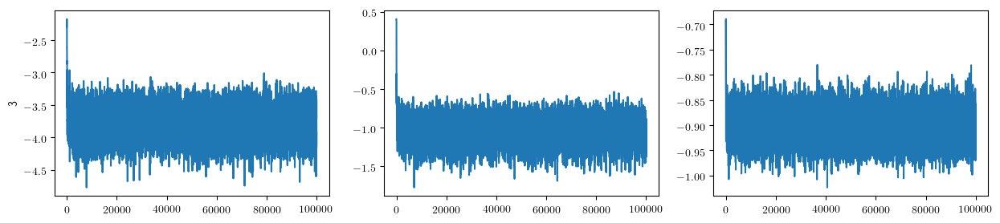

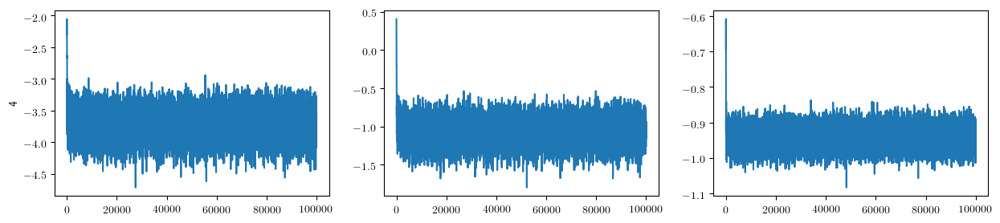

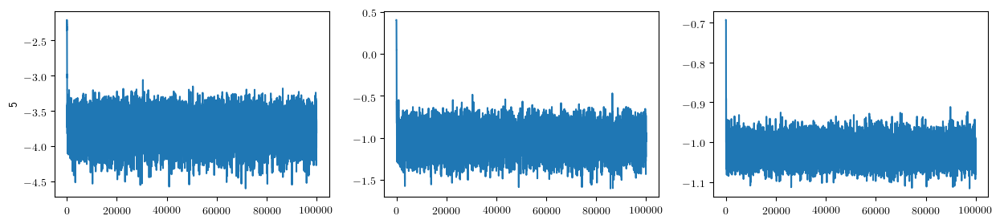

...

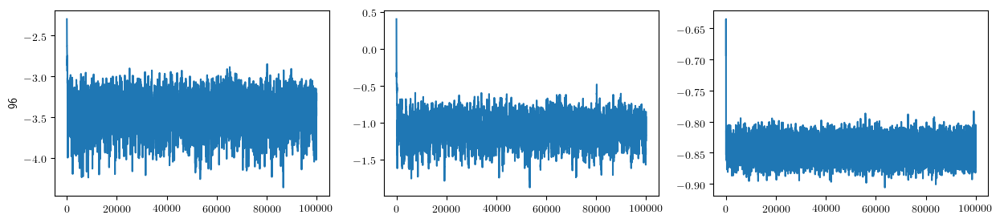

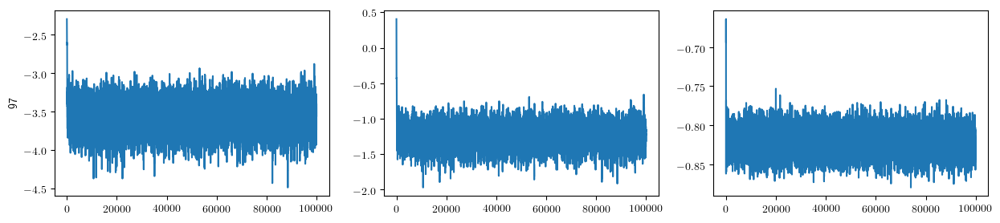

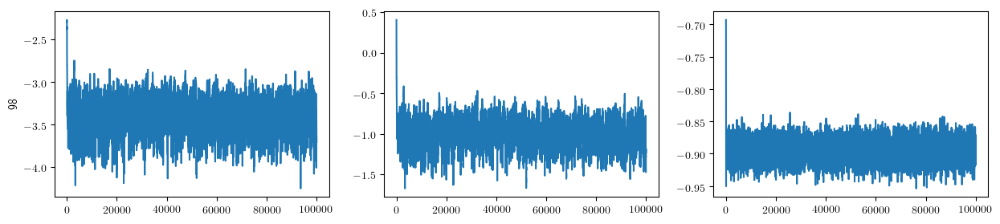

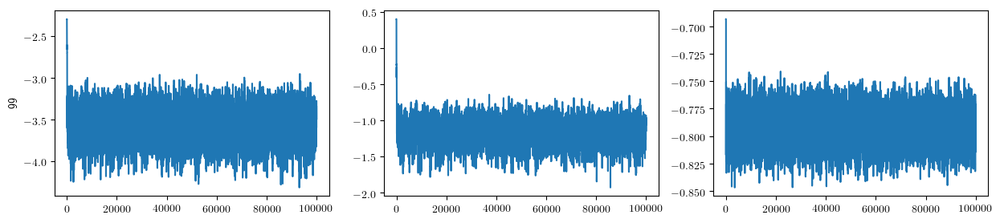

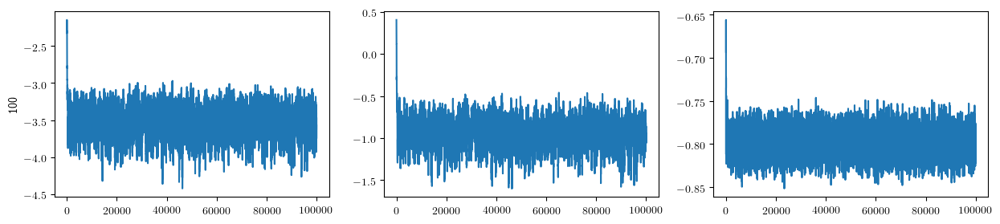

In [20]:
for i in 1:M_subjects
    
    PyPlot.figure(figsize=(15,3))

    
    ax1 = PyPlot.subplot(1,3,1)

    PyPlot.plot(chain_ϕ_cpmmh[i,1,burn_in_trace:end])
    PyPlot.ylabel(i)
    
    ax1 = PyPlot.subplot(1,3,2)
    PyPlot.plot(chain_ϕ_cpmmh[i,2,burn_in_trace:end])

    ax1 = PyPlot.subplot(1,3,3)
    PyPlot.plot(chain_ϕ_cpmmh[i,3,burn_in_trace:end])
end 


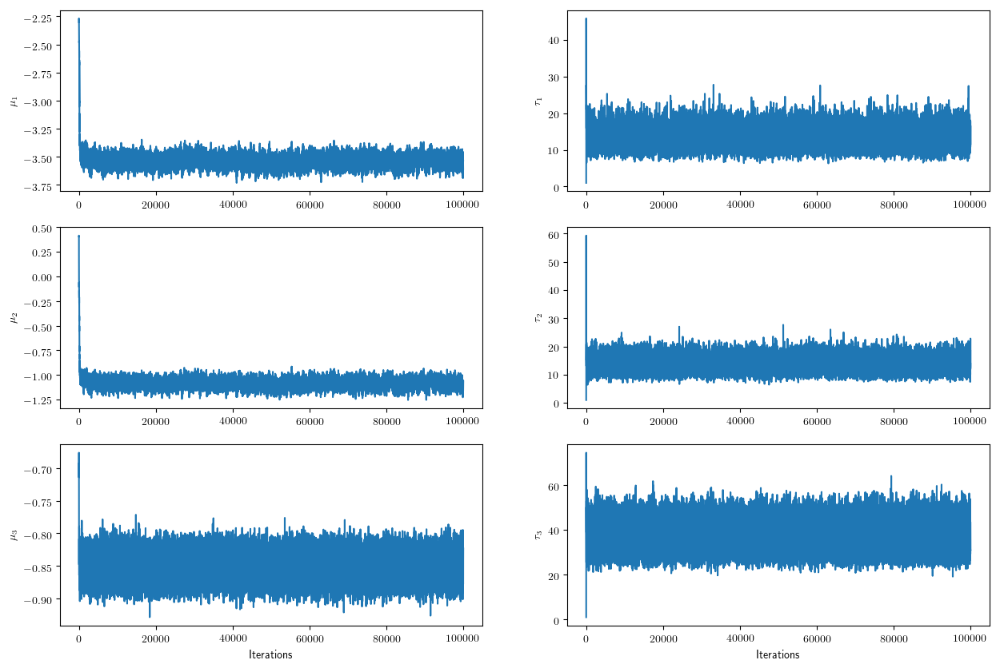

In [21]:
PyPlot.figure(figsize=(15,10))

ax1 = PyPlot.subplot(3,2,1)
PyPlot.plot(chain_η_cpmmh[1,burn_in_trace:end])
PyPlot.ylabel(L"\mu_1")

ax1 = PyPlot.subplot(3,2,3)
PyPlot.plot(chain_η_cpmmh[2,burn_in_trace:end])
PyPlot.ylabel(L"\mu_2")

ax1 = PyPlot.subplot(3,2,5)
PyPlot.plot(chain_η_cpmmh[3,burn_in_trace:end])
PyPlot.ylabel(L"\mu_3")
PyPlot.xlabel("Iterations");

ax1 = PyPlot.subplot(3,2,2)
PyPlot.plot(chain_η_cpmmh[4,burn_in_trace:end])
PyPlot.ylabel(L"\tau_1")

ax1 = PyPlot.subplot(3,2,4)
PyPlot.plot(chain_η_cpmmh[5,burn_in_trace:end])
PyPlot.ylabel(L"\tau_2")

ax1 = PyPlot.subplot(3,2,6)
PyPlot.plot(chain_η_cpmmh[6,burn_in_trace:end])
PyPlot.ylabel(L"\tau_3")
PyPlot.xlabel("Iterations");

## CPMMH - 0.900

In [22]:
ρ = 0.9
nbr_particles = 1

job = string(M_subjects)*"_"*string(ρ)*"_"*string(nbr_particles)*"_bridge"


"100_0.9_1_bridge"

In [23]:
chain_σ_ϵ_cpmmh09 = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_sigma_epsilon_"*string(seed)*"_"*job*".csv",allowmissing=:auto))

chain_σ_ϵ_cpmmh09 = Matrix(chain_σ_ϵ_cpmmh09')
chain_η_cpmmh09 = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_eta_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_η_cpmmh09 = Matrix(chain_η_cpmmh09')
chain_ϕ_export_cpmmh09 = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_phi_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_ϕ_export_cpmmh09 = Matrix(chain_ϕ_export_cpmmh09')
chain_ϕ_cpmmh09 = zeros(M_subjects,3,R)

idx = 0 
for m = 1:M_subjects
    for j = 1:3
        idx = idx + 1
        chain_ϕ_cpmmh09[m,j,:] = chain_ϕ_export_cpmmh09[idx,:]
    end 
end 


simdata_cpmmh09 = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/sim_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
println(simdata_cpmmh[1])
println(simdata_cpmmh[2])
println(simdata_cpmmh[3])
println(simdata_cpmmh[4])

loglik_data = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/loglik_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto));


┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


39329.099799714
0.2494622
0.24812
1.0


┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


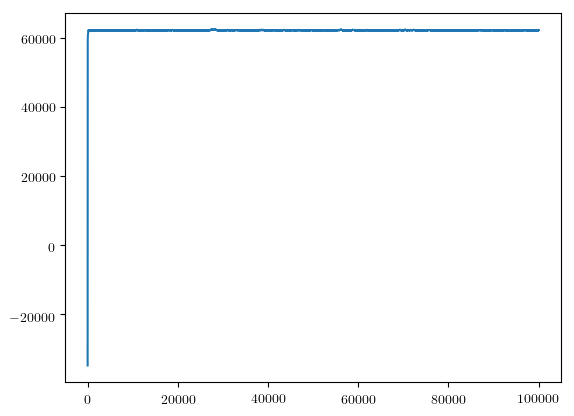

1-element Array{PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f49fda612b0>

In [26]:
PyPlot.figure()
PyPlot.plot(loglik_data)

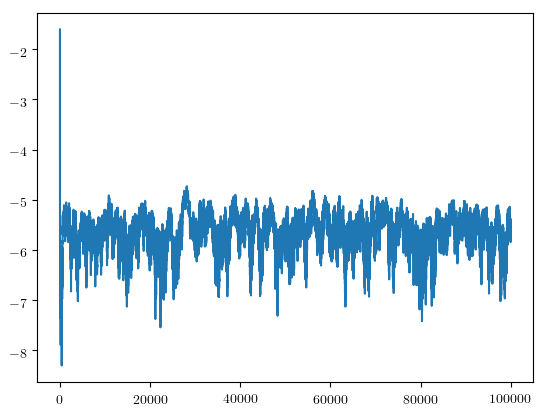

1-element Array{PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7fb3ca7ce080>

In [24]:
PyPlot.figure()
PyPlot.plot(chain_σ_ϵ_cpmmh09[1,burn_in_trace:end])
#PyPlot.ylabel(L"\sigma_{\epsilon}")
#PyPlot.xlabel("Iteration

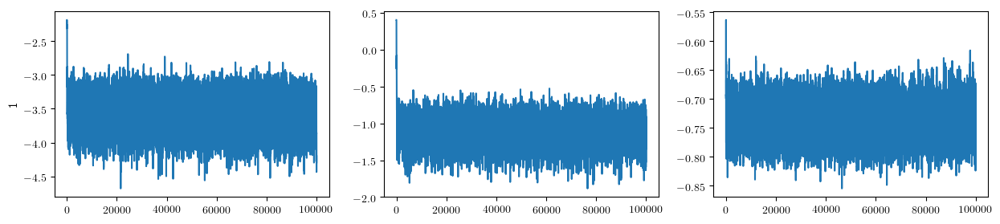

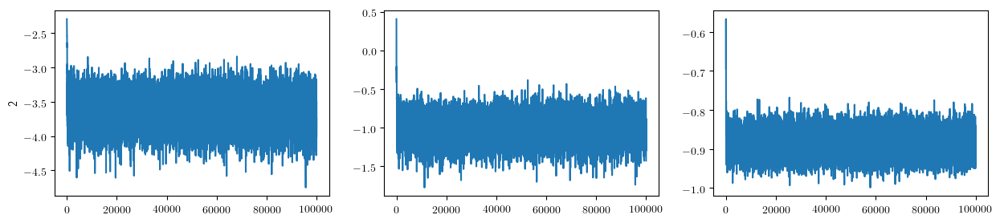

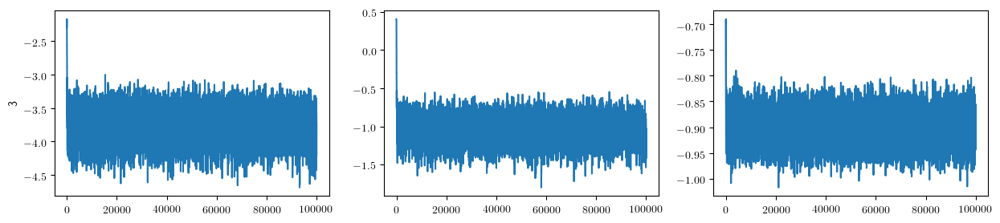

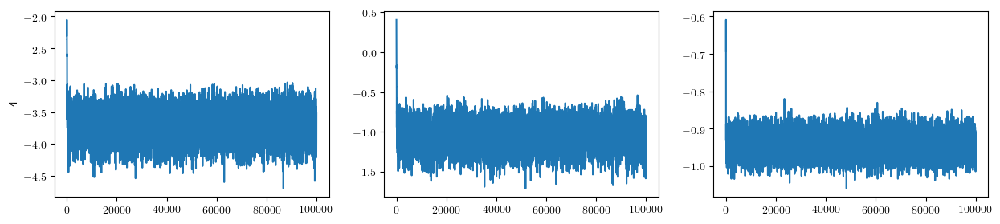

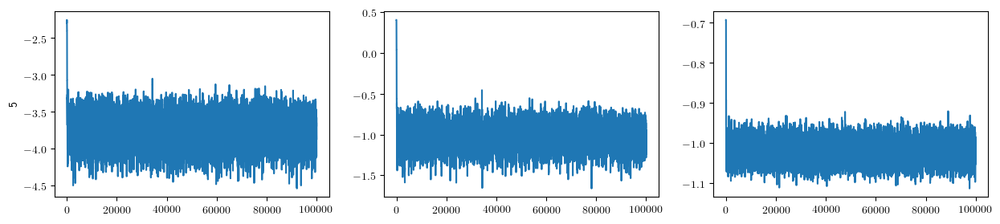

...

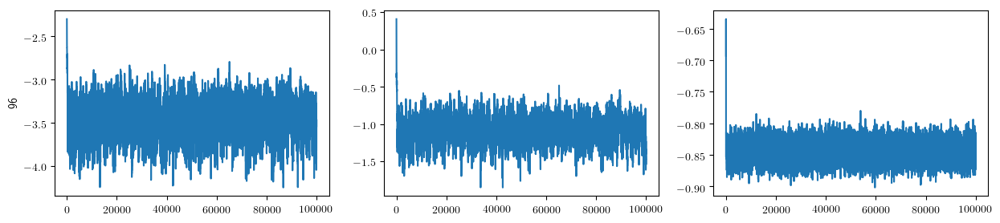

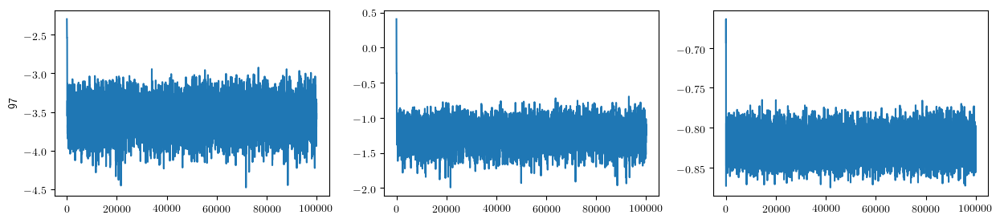

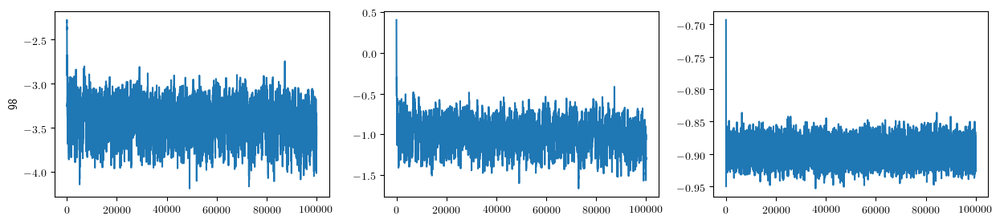

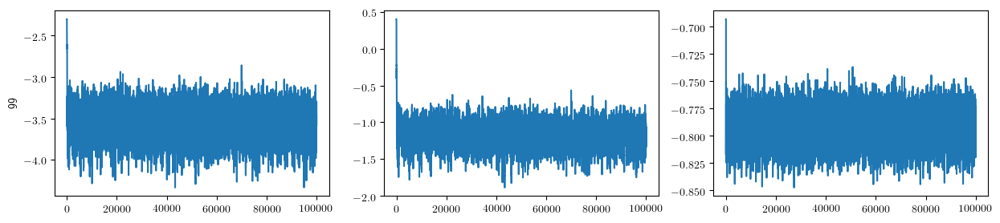

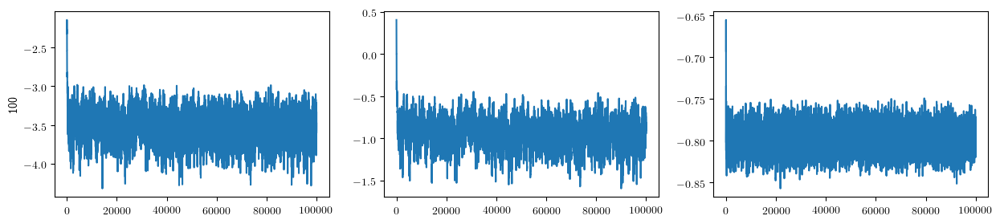

In [25]:
for i in 1:M_subjects
    
    PyPlot.figure(figsize=(15,3))

    
    ax1 = PyPlot.subplot(1,3,1)

    PyPlot.plot(chain_ϕ_cpmmh09[i,1,burn_in_trace:end])
    PyPlot.ylabel(i)
    
    ax1 = PyPlot.subplot(1,3,2)
    PyPlot.plot(chain_ϕ_cpmmh09[i,2,burn_in_trace:end])

    ax1 = PyPlot.subplot(1,3,3)
    PyPlot.plot(chain_ϕ_cpmmh09[i,3,burn_in_trace:end])
end 

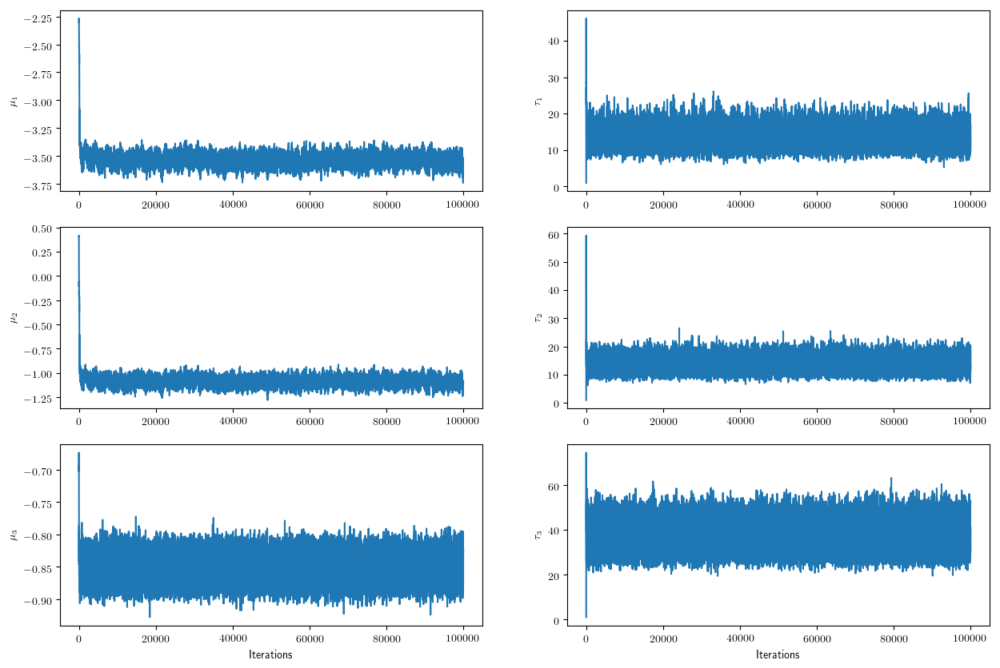

In [26]:
PyPlot.figure(figsize=(15,10))

ax1 = PyPlot.subplot(3,2,1)
PyPlot.plot(chain_η_cpmmh09[1,burn_in_trace:end])
PyPlot.ylabel(L"\mu_1")

ax1 = PyPlot.subplot(3,2,3)
PyPlot.plot(chain_η_cpmmh09[2,burn_in_trace:end])
PyPlot.ylabel(L"\mu_2")

ax1 = PyPlot.subplot(3,2,5)
PyPlot.plot(chain_η_cpmmh09[3,burn_in_trace:end])
PyPlot.ylabel(L"\mu_3")
PyPlot.xlabel("Iterations");

ax1 = PyPlot.subplot(3,2,2)
PyPlot.plot(chain_η_cpmmh09[4,burn_in_trace:end])
PyPlot.ylabel(L"\tau_1")

ax1 = PyPlot.subplot(3,2,4)
PyPlot.plot(chain_η_cpmmh09[5,burn_in_trace:end])
PyPlot.ylabel(L"\tau_2")

ax1 = PyPlot.subplot(3,2,6)
PyPlot.plot(chain_η_cpmmh09[6,burn_in_trace:end])
PyPlot.ylabel(L"\tau_3")
PyPlot.xlabel("Iterations");

## CPMMH bootstrap

In [37]:

ρ = 0.99
nbr_particles = 100

job = string(M_subjects)*"_"*string(ρ)*"_100_bootstrap"

R = 35000

35000

In [38]:
"data/SDEMEM OU neuron data/cpmmh/chain_sigma_epsilon_"*string(seed)*"_"*job*".csv"

"data/SDEMEM OU neuron data/cpmmh/chain_sigma_epsilon_100_100_0.99_100_bootstrap.csv"

In [39]:
chain_σ_ϵ_cpmmh_bootstrap = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_sigma_epsilon_"*string(seed)*"_"*job*".csv",allowmissing=:auto))

chain_σ_ϵ_cpmmh_bootstrap = Matrix(chain_σ_ϵ_cpmmh_bootstrap')
chain_η_cpmmh_bootstrap = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_eta_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_η_cpmmh_bootstrap = Matrix(chain_η_cpmmh_bootstrap')
chain_ϕ_export_cpmmh_bootstrap = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/chain_phi_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
chain_ϕ_export_cpmmh_bootstrap = Matrix(chain_ϕ_export_cpmmh_bootstrap')
chain_ϕ_cpmmh_bootstrap = zeros(M_subjects,3,R)

idx = 0 
for m = 1:M_subjects
    for j = 1:3
        idx = idx + 1
        chain_ϕ_cpmmh_bootstrap[m,j,:] = chain_ϕ_export_cpmmh_bootstrap[idx,:]
    end 
end 


simdata_cpmmh09 = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/sim_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto))
println(simdata_cpmmh[1])
println(simdata_cpmmh[2])
println(simdata_cpmmh[3])
println(simdata_cpmmh[4])

loglik_data = Matrix(CSV.read("data/SDEMEM OU neuron data/cpmmh/loglik_data_"*string(seed)*"_"*job*".csv",allowmissing=:auto));


┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330
┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


39329.099799714
0.2494622
0.24812
1.0


┌ Warning: `allowmissing` is a deprecated keyword argument
└ @ CSV /home/samuel/.julia/packages/CSV/76SRf/src/CSV.jl:330


# Plots

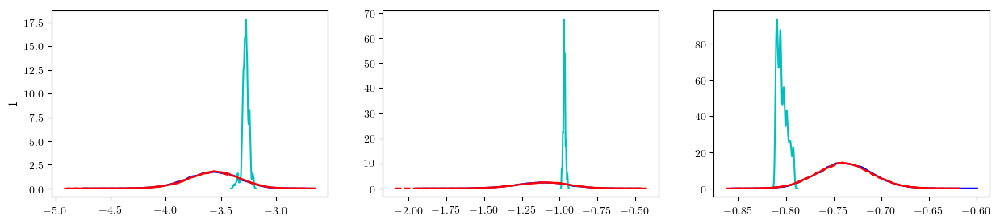

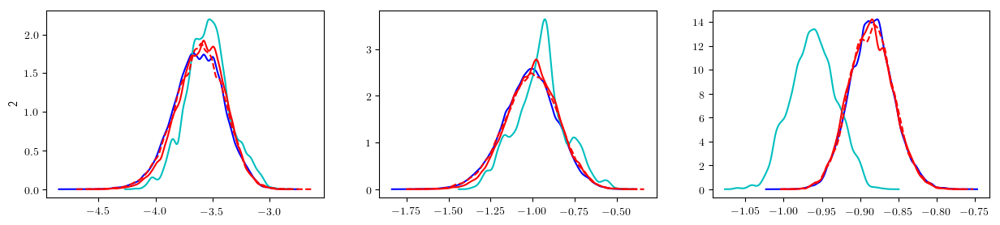

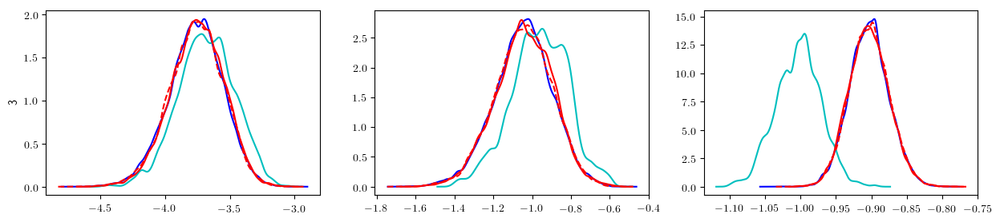

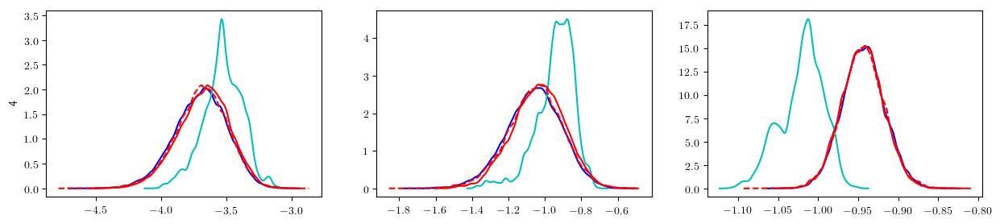

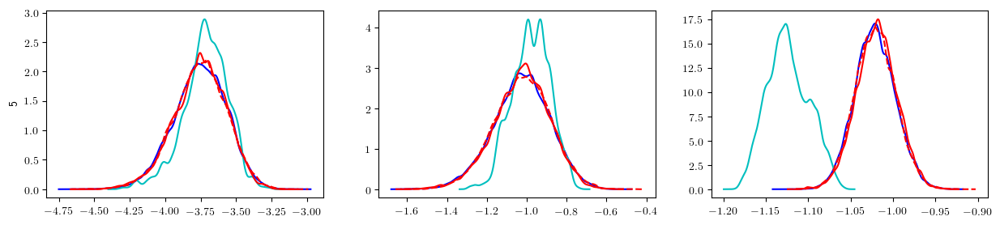

...

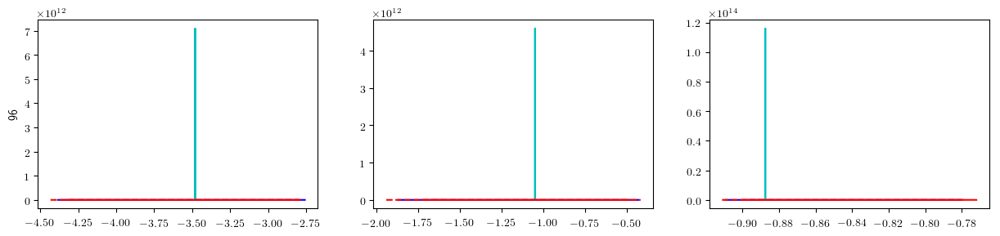

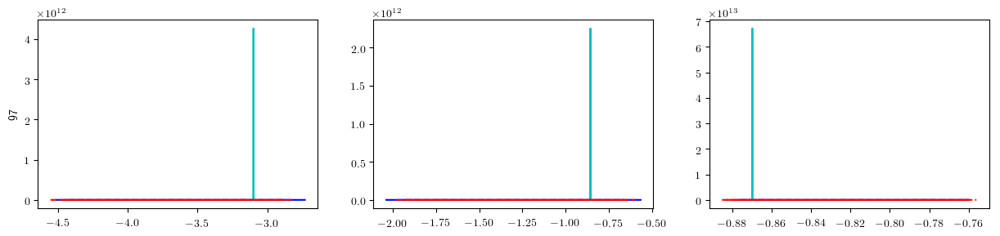

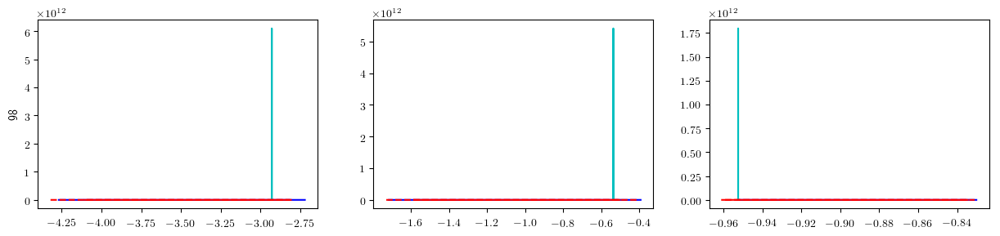

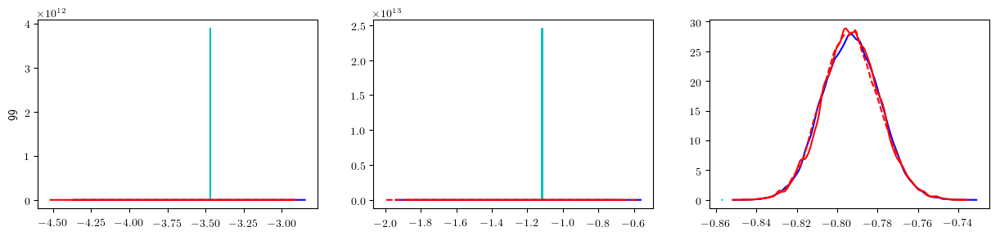

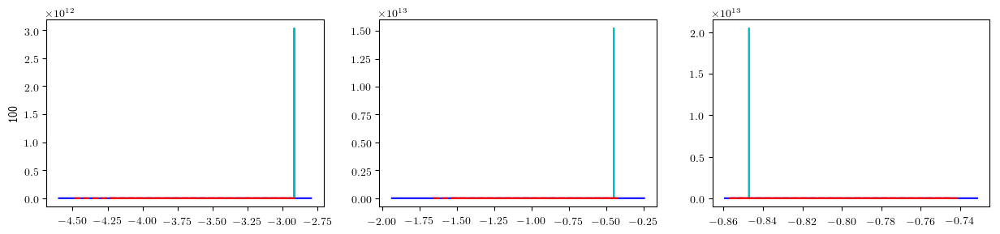

In [53]:
for m in 1:M_subjects
    
    posterior_kalman1 = kde(chain_ϕ_kalman[m,1,burn_in:end])
    posterior_bootstrap1 = kde(chain_ϕ_cpmmh_bootstrap[m,1,burn_in:end])
    #posterior_bridge1 = kde(chain_ϕ_cpmmh_bridge[m,1,burn_in:end])
    posterior_pmmh1 = kde(chain_ϕ_pmmh[m,1,burn_in:end])
    posterior_cpmmh1 = kde(chain_ϕ_cpmmh[m,1,burn_in:end])

    posterior_kalman2 = kde(chain_ϕ_kalman[m,2,burn_in:end])
    posterior_bootstrap2 = kde(chain_ϕ_cpmmh_bootstrap[m,2,burn_in:end])
    #posterior_bridge2 = kde(chain_ϕ_cpmmh_bridge[m,2,burn_in:end])
    posterior_pmmh2 = kde(chain_ϕ_pmmh[m,2,burn_in:end])
    posterior_cpmmh2 = kde(chain_ϕ_cpmmh[m,2,burn_in:end])

    posterior_kalman3 = kde(chain_ϕ_kalman[m,3,burn_in:end])
    posterior_bootstrap3 = kde(chain_ϕ_cpmmh_bootstrap[m,3,burn_in:end])
    #posterior_bridge3 = kde(chain_ϕ_cpmmh_bridge[m,3,burn_in:end])
    posterior_pmmh3 = kde(chain_ϕ_pmmh[m,3,burn_in:end])
    posterior_cpmmh3 = kde(chain_ϕ_cpmmh[m,3,burn_in:end])

    
    PyPlot.figure(figsize=(15,3))

    ax1 = PyPlot.subplot(1,3,1)

    PyPlot.plot(posterior_kalman1.x,posterior_kalman1.density, "b")        
    PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
    #PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "--c")
    PyPlot.plot(posterior_pmmh1.x,posterior_pmmh1.density, "r")
    PyPlot.plot(posterior_cpmmh1.x,posterior_cpmmh1.density, "--r")
    
    PyPlot.ylabel(m)
    
    ax1 = PyPlot.subplot(1,3,2)
    PyPlot.plot(posterior_kalman2.x,posterior_kalman2.density, "b")        
    PyPlot.plot(posterior_bootstrap2.x,posterior_bootstrap2.density, "c")
    #PyPlot.plot(posterior_bridge2.x,posterior_bridge2.density, "--c")
    PyPlot.plot(posterior_pmmh2.x,posterior_pmmh2.density, "r")
    PyPlot.plot(posterior_cpmmh2.x,posterior_cpmmh2.density, "--r")

    ax1 = PyPlot.subplot(1,3,3)
    PyPlot.plot(posterior_kalman3.x,posterior_kalman3.density, "b")        
    PyPlot.plot(posterior_bootstrap3.x,posterior_bootstrap3.density, "c")
    #PyPlot.plot(posterior_bridge3.x,posterior_bridge3.density, "--c")
    PyPlot.plot(posterior_pmmh3.x,posterior_pmmh3.density, "r")
    PyPlot.plot(posterior_cpmmh3.x,posterior_cpmmh3.density, "--r")


end

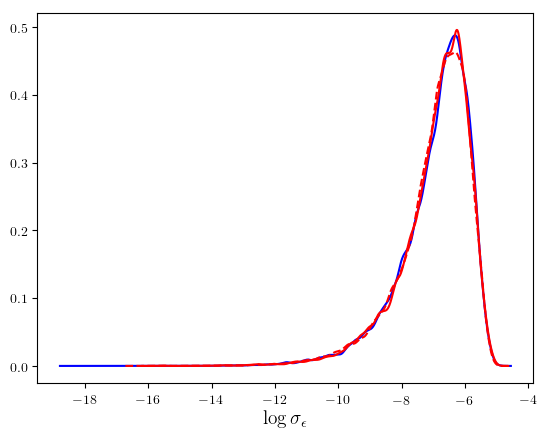

In [51]:
#= 

# Depreciated

prior_grid = LinRange(-13,1,100)
prior = pdf.(Normal(prior_parameters_σ_ϵ[1],1/prior_parameters_σ_ϵ[2]),prior_grid)

# TODO scaling????

scale_factor = 1
posterior_kalman = kde(chain_σ_ϵ_kalman[burn_in:end])
#posterior_bootstrap = kde(chain_σ_ϵ_cpmmh_bootstrap[burn_in:end])
#posterior_bridge = kde(chain_σ_ϵ_cpmmh_bridge[burn_in:end])
posterior_pmmh = kde(chain_σ_ϵ_pmmh[burn_in:end])

posterior_cpmmh = kde(chain_σ_ϵ_cpmmh[burn_in:end])


PyPlot.figure()
#PyPlot.plot(prior_grid,prior, "k")
PyPlot.plot(posterior_kalman.x,scale_factor*posterior_kalman.density, "b")
#PyPlot.plot(posterior_bootstrap.x,posterior_bootstrap.density, "c")
#PyPlot.plot(posterior_bridge.x,scale_factor*posterior_bridge.density, "--c")
PyPlot.plot(posterior_pmmh.x,scale_factor*posterior_pmmh.density, "r")
PyPlot.plot(posterior_cpmmh.x,scale_factor*posterior_cpmmh.density, "r--")

#PyPlot.plot(posterior_bridge0999.x,scale_factor*posterior_bridge0999.density, "k-.")
#PyPlot.xlim((minimum([minimum(posterior_kalman.x);
#             minimum(posterior_bootstrap.x);
#             minimum(posterior_bridge.x)])-0.2, maximum([maximum(posterior_kalman.x);
#                                                         maximum(posterior_bootstrap.x);
#                                                         maximum(posterior_bridge.x)])+0.2));

#PyPlot.xlim((minimum([minimum(posterior_bootstrap.x);
#             minimum(posterior_bridge.x)])-0.2, maximum([maximum(posterior_bootstrap.x);
#                                                         maximum(posterior_bridge.x)])+0.2));
PyPlot.xlabel(L"\log \sigma_{\epsilon}",fontsize=14)

if false
    PyPlot.savefig("figures/ou_marginal_post_sigma.pdf", format="pdf", dpi=1000)
    run(`pdftops -eps figures/ou_marginal_post_sigma.pdf figures/ou_marginal_post_sigma.eps`)
end

In [30]:
save_plots = true

true

In [31]:
burn_in = 20000

20000

In [18]:
#= 

# Depreciated

prior_grid = LinRange(-13,1,100)
prior = pdf.(Normal(prior_parameters_σ_ϵ[1],1/prior_parameters_σ_ϵ[2]),prior_grid)

#burn_in_cppmh = 5000
# TODO scaling????

scale_factor = 1
posterior_kalman = kde(chain_σ_ϵ_kalman[burn_in:end])
posterior_pmmh = kde(chain_σ_ϵ_pmmh[burn_in:end])
posterior_cpmmh = kde(chain_σ_ϵ_cpmmh[burn_in:end])
posterior_cpmmh09 = kde(chain_σ_ϵ_cpmmh09[burn_in:end])

UnivariateKDE{StepRangeLen{Float64,Base.TwicePrecision{Float64},Base.TwicePrecision{Float64}}}(-15.774231029848274:0.005429900710057319:-4.659224276360942, [2.17583e-7, 1.78753e-7, 1.51145e-7, 1.33076e-7, 1.23333e-7, 1.21111e-7, 1.25962e-7, 1.37768e-7, 1.56709e-7, 1.83253e-7  …  2.14146e-6, 1.71358e-6, 1.36694e-6, 1.08724e-6, 8.62526e-7, 6.82829e-7, 5.39903e-7, 4.2696e-7, 3.38446e-7, 2.69859e-7])

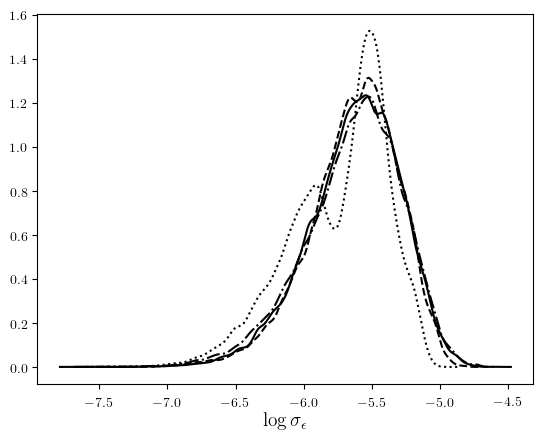

Process(`pdftops -eps figures/ou_marginal_post_sigma_new.pdf figures/ou_marginal_post_sigma_new.eps`, ProcessExited(0))

In [40]:
# Fig 6

prior_grid = LinRange(-13,1,100)
prior = pdf.(Normal(prior_parameters_σ_ϵ[1],1/prior_parameters_σ_ϵ[2]),prior_grid)

#burn_in_cppmh = 5000
# TODO scaling????

scale_factor = 1
posterior_kalman = kde(chain_σ_ϵ_kalman[burn_in:end])
posterior_pmmh = kde(chain_σ_ϵ_pmmh[burn_in:end])
posterior_cpmmh = kde(chain_σ_ϵ_cpmmh[burn_in:end])
posterior_cpmmh09 = kde(chain_σ_ϵ_cpmmh09[burn_in:end])

PyPlot.figure()
#PyPlot.plot(prior_grid,prior, "k")
PyPlot.plot(posterior_kalman.x,scale_factor*posterior_kalman.density, "k")
PyPlot.plot(posterior_pmmh.x,posterior_pmmh.density, "k--")
PyPlot.plot(posterior_cpmmh.x,scale_factor*posterior_cpmmh.density, "k:")
PyPlot.plot(posterior_cpmmh09.x,scale_factor*posterior_cpmmh09.density, "k-.")

#PyPlot.plot(posterior_bridge0999.x,scale_factor*posterior_bridge0999.density, "k-.")
#PyPlot.xlim((minimum([minimum(posterior_kalman.x);
#             minimum(posterior_bootstrap.x);
#             minimum(posterior_bridge.x)])-0.2, maximum([maximum(posterior_kalman.x);
#                                                         maximum(posterior_bootstrap.x);
#                                                         maximum(posterior_bridge.x)])+0.2));

#PyPlot.xlim((minimum([minimum(posterior_pmmh.x);
#             minimum(posterior_cpmmh.x)])-0.2, maximum([maximum(posterior_pmmh.x);
#                                                         maximum(posterior_cpmmh.x)])+0.2));
PyPlot.xlabel(L"\log \sigma_{\epsilon}",fontsize=14)

if save_plots
    PyPlot.savefig("figures/ou_marginal_post_sigma_new.pdf", format="pdf", dpi=1000)
    run(`pdftops -eps figures/ou_marginal_post_sigma_new.pdf figures/ou_marginal_post_sigma_new.eps`)
end

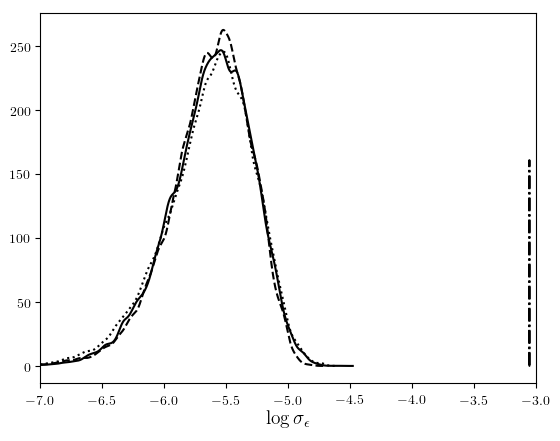

Process(`pdftops -eps figures/ou_marginal_post_sigma_appendix_new.pdf figures/ou_marginal_post_sigma_appendix_new.eps`, ProcessExited(0))

In [47]:
# Fig 6 appendix

prior_grid = LinRange(-13,1,100)
prior = pdf.(Normal(prior_parameters_σ_ϵ[1],1/prior_parameters_σ_ϵ[2]),prior_grid)

#burn_in_cppmh = 5000
# TODO scaling????

scale_factor = 200
posterior_kalman = kde(chain_σ_ϵ_kalman[burn_in:end])
posterior_pmmh = kde(chain_σ_ϵ_pmmh[burn_in:end])
posterior_cpmmh = kde(chain_σ_ϵ_cpmmh09[burn_in:end])
posterior_cpmmh_bootstrap = kde(chain_σ_ϵ_cpmmh_bootstrap[10000:end])

PyPlot.figure()
#PyPlot.plot(prior_grid,prior, "k")
PyPlot.plot(posterior_kalman.x,scale_factor*posterior_kalman.density, "k")
PyPlot.plot(posterior_pmmh.x,scale_factor*posterior_pmmh.density, "k--")
PyPlot.plot(posterior_cpmmh.x,scale_factor*posterior_cpmmh.density, "k:")
PyPlot.plot(posterior_cpmmh_bootstrap.x,posterior_cpmmh_bootstrap.density/scale_factor, "k-.")

#PyPlot.plot(posterior_bridge0999.x,scale_factor*posterior_bridge0999.density, "k-.")
#PyPlot.xlim((minimum([minimum(posterior_kalman.x);
#             minimum(posterior_bootstrap.x);
#             minimum(posterior_bridge.x)])-0.2, maximum([maximum(posterior_kalman.x);
#                                                         maximum(posterior_bootstrap.x);
#                                                         maximum(posterior_bridge.x)])+0.2));

#PyPlot.xlim((minimum([minimum(posterior_pmmh.x);
#             minimum(posterior_cpmmh.x)])-0.2, maximum([maximum(posterior_pmmh.x);
#                                                         maximum(posterior_cpmmh.x)])+0.2));

PyPlot.xlim((-7,-3))
PyPlot.xlabel(L"\log \sigma_{\epsilon}",fontsize=14)

if save_plots
    PyPlot.savefig("figures/ou_marginal_post_sigma_appendix_new.pdf", format="pdf", dpi=1000)
    run(`pdftops -eps figures/ou_marginal_post_sigma_appendix_new.pdf figures/ou_marginal_post_sigma_appendix_new.eps`)
end

In [55]:
save_plots = true

true

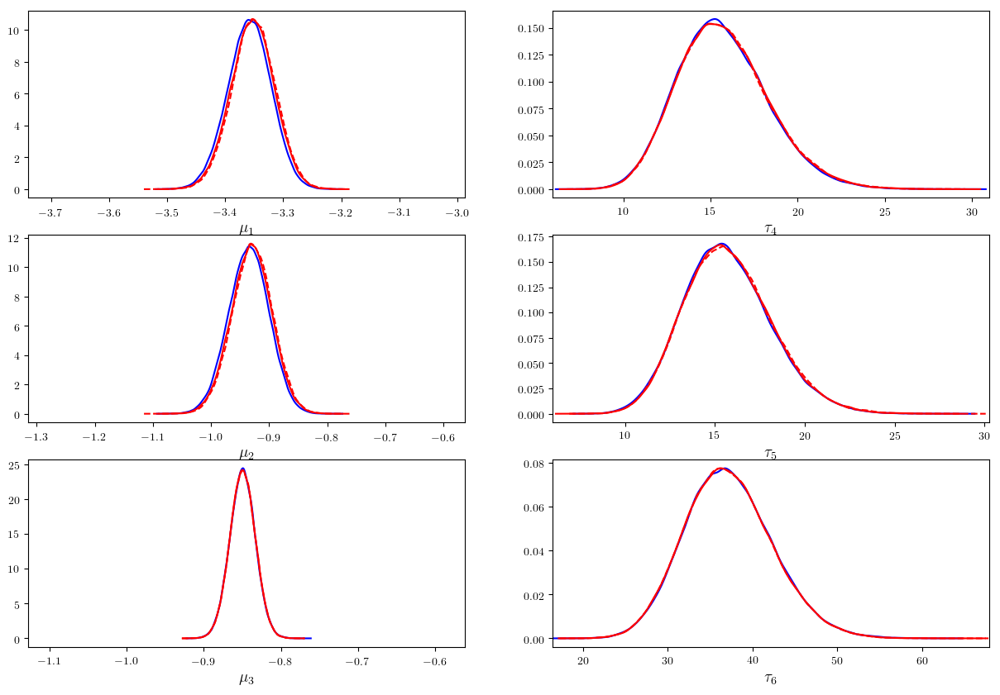

In [52]:
#= 

# Depreciated
prior_grid_tau = LinRange(0,8,100)
prior_grid_tau2 = LinRange(0,20,100)

prior_tau1 = pdf.(Gamma(prior_parameters_η[1,3],1/prior_parameters_η[1,4]),prior_grid_tau)
prior_tau2 = pdf.(Gamma(prior_parameters_η[2,3],1/prior_parameters_η[2,4]),prior_grid_tau2)
prior_tau3 = pdf.(Gamma(prior_parameters_η[3,3],1/prior_parameters_η[3,4]),prior_grid_tau)

prior_grid_mu1 = prior_grid = LinRange(-6, -1,100)
prior_grid_mu2 = prior_grid = LinRange(-2,0,100)
prior_grid_mu3 = prior_grid = LinRange(-3,0,100)


tau1 = prior_parameters_η[1,3]/prior_parameters_η[1,4]
tau2 = prior_parameters_η[2,3]/prior_parameters_η[2,4]
tau3 = prior_parameters_η[3,3]/prior_parameters_η[3,4]

prior_mu1 = pdf.(Normal(prior_parameters_η[1,1],sqrt(1/(prior_parameters_η[1,2]*tau1))),prior_grid_mu1)
prior_mu2 = pdf.(Normal(prior_parameters_η[2,1],sqrt(1/(prior_parameters_η[2,2]*tau2))),prior_grid_mu2)
prior_mu3 = pdf.(Normal(prior_parameters_η[3,1],sqrt(1/(prior_parameters_η[3,2]*tau3))),prior_grid_mu3)

posterior_kalman1 = kde(chain_η_kalman[1,burn_in:end])
#posterior_bootstrap1 = kde(chain_η_cpmmh_bootstrap[1,burn_in:end])
#posterior_bridge1 = kde(chain_η_cpmmh_bridge[1,burn_in:end])
posterior_pmmh1 = kde(chain_η_pmmh[1,burn_in:end])
posterior_cpmmh1 = kde(chain_η_cpmmh[1,burn_in:end])

posterior_kalman2 = kde(chain_η_kalman[2,burn_in:end])
#posterior_bootstrap2 = kde(chain_η_cpmmh_bootstrap[2,burn_in:end])
#posterior_bridge2 = kde(chain_η_cpmmh_bridge[2,burn_in:end])
posterior_pmmh2 = kde(chain_η_pmmh[2,burn_in:end])
posterior_cpmmh2 = kde(chain_η_cpmmh[2,burn_in:end])

posterior_kalman3 = kde(chain_η_kalman[3,burn_in:end])
#posterior_bootstrap3 = kde(chain_η_cpmmh_bootstrap[3,burn_in:end])
#posterior_bridge3 = kde(chain_η_cpmmh_bridge[3,burn_in:end])
posterior_pmmh3 = kde(chain_η_pmmh[3,burn_in:end])
posterior_cpmmh3 = kde(chain_η_cpmmh[3,burn_in:end])

posterior_kalman4 = kde(chain_η_kalman[4,burn_in:end])
#posterior_bootstrap4 = kde(chain_η_cpmmh_bootstrap[4,burn_in:end])
#posterior_bridge4 = kde(chain_η_cpmmh_bridge[4,burn_in:end])
posterior_pmmh4 = kde(chain_η_pmmh[4,burn_in:end])
posterior_cpmmh4 = kde(chain_η_cpmmh[4,burn_in:end])

posterior_kalman5 = kde(chain_η_kalman[5,burn_in:end])
#posterior_bootstrap5 = kde(chain_η_cpmmh_bootstrap[5,burn_in:end])
#posterior_bridge5 = kde(chain_η_cpmmh_bridge[5,burn_in:end])
posterior_pmmh5 = kde(chain_η_pmmh[5,burn_in:end])
posterior_cpmmh5 = kde(chain_η_cpmmh[5,burn_in:end])

posterior_kalman6 = kde(chain_η_kalman[6,burn_in:end])
#posterior_bootstrap6 = kde(chain_η_cpmmh_bootstrap[6,burn_in:end])
#posterior_bridge6 = kde(chain_η_cpmmh_bridge[6,burn_in:end])
posterior_pmmh6 = kde(chain_η_pmmh[6,burn_in:end])
posterior_cpmmh6 = kde(chain_η_cpmmh[6,burn_in:end])

PyPlot.figure(figsize=(15,10))

ax1 = PyPlot.subplot(3,2,1)
#PyPlot.plot(prior_grid_mu1,prior_mu1, "k")
PyPlot.plot(posterior_kalman1.x,posterior_kalman1.density, "b")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh1.x,posterior_pmmh1.density, "r")
PyPlot.plot(posterior_cpmmh1.x,posterior_cpmmh1.density, "r--")




#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman1.x);
             minimum(posterior_pmmh1.x);
             minimum(posterior_cpmmh1.x)])-0.2, maximum([maximum(posterior_kalman1.x);
                                                         maximum(posterior_pmmh1.x);
                                                         maximum(posterior_cpmmh1.x)])+0.2));
PyPlot.xlabel(L"\mu_1",fontsize=14)


ax1 = PyPlot.subplot(3,2,3)
#PyPlot.plot(prior_grid_mu2,prior_mu2, "k")
PyPlot.plot(posterior_kalman2.x,posterior_kalman2.density, "b")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh2.x,posterior_pmmh2.density, "r")
PyPlot.plot(posterior_cpmmh2.x,posterior_cpmmh2.density, "r--")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman2.x);
             minimum(posterior_pmmh2.x);
             minimum(posterior_cpmmh2.x)])-0.2, maximum([maximum(posterior_kalman2.x);
                                                         maximum(posterior_pmmh2.x);
                                                         maximum(posterior_cpmmh2.x)])+0.2));
PyPlot.xlabel(L"\mu_2",fontsize=14)



ax1 = PyPlot.subplot(3,2,5)
#PyPlot.plot(prior_grid_mu3,prior_mu3, "g")
PyPlot.plot(posterior_kalman3.x,posterior_kalman3.density, "b")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh3.x,posterior_pmmh3.density, "r")
PyPlot.plot(posterior_cpmmh3.x,posterior_cpmmh3.density, "r--")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman3.x);
             minimum(posterior_pmmh3.x);
             minimum(posterior_cpmmh3.x)])-0.2, maximum([maximum(posterior_kalman3.x);
                                                         maximum(posterior_pmmh3.x);
                                                         maximum(posterior_cpmmh3.x)])+0.2));
PyPlot.xlabel(L"\mu_3",fontsize=14)


ax1 = PyPlot.subplot(3,2,2)
#PyPlot.plot(prior_grid_tau,prior_tau1, "k")
PyPlot.plot(posterior_kalman4.x,posterior_kalman4.density, "b")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh4.x,posterior_pmmh4.density, "r")
PyPlot.plot(posterior_cpmmh4.x,posterior_cpmmh4.density, "r--")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman4.x);
             minimum(posterior_pmmh4.x);
             minimum(posterior_cpmmh4.x)])-0.2, maximum([maximum(posterior_kalman4.x);
                                                         maximum(posterior_pmmh4.x);
                                                         maximum(posterior_cpmmh4.x)])+0.2));
PyPlot.xlabel(L"\tau_4",fontsize=14)


ax1 = PyPlot.subplot(3,2,4)
#PyPlot.plot(prior_grid_tau2,prior_tau2, "k")
PyPlot.plot(posterior_kalman5.x,posterior_kalman5.density, "b")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh5.x,posterior_pmmh5.density, "r")
PyPlot.plot(posterior_cpmmh5.x,posterior_cpmmh5.density, "r--")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman5.x);
             minimum(posterior_pmmh5.x);
             minimum(posterior_cpmmh5.x)])-0.2, maximum([maximum(posterior_kalman5.x);
                                                         maximum(posterior_pmmh5.x);
                                                         maximum(posterior_cpmmh5.x)])+0.2));
PyPlot.xlabel(L"\tau_5",fontsize=14)
    

ax1 = PyPlot.subplot(3,2,6)
#PyPlot.plot(prior_grid_tau,prior_tau3, "k")
PyPlot.plot(posterior_kalman6.x,posterior_kalman6.density, "b")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh6.x,posterior_pmmh6.density, "r")
PyPlot.plot(posterior_cpmmh6.x,posterior_cpmmh6.density, "r--")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman6.x);
             minimum(posterior_pmmh6.x);
             minimum(posterior_cpmmh6.x)])-0.2, maximum([maximum(posterior_kalman6.x);
                                                         maximum(posterior_pmmh6.x);
                                                         maximum(posterior_cpmmh6.x)])+0.2));
PyPlot.xlabel(L"\tau_6",fontsize=14);


if false
    PyPlot.savefig("figures/ou_marginal_post_eta.pdf", format="pdf", dpi=1000)
    run(`pdftops -eps figures/ou_marginal_post_eta.pdf figures/ou_marginal_post_eta.eps`)
end

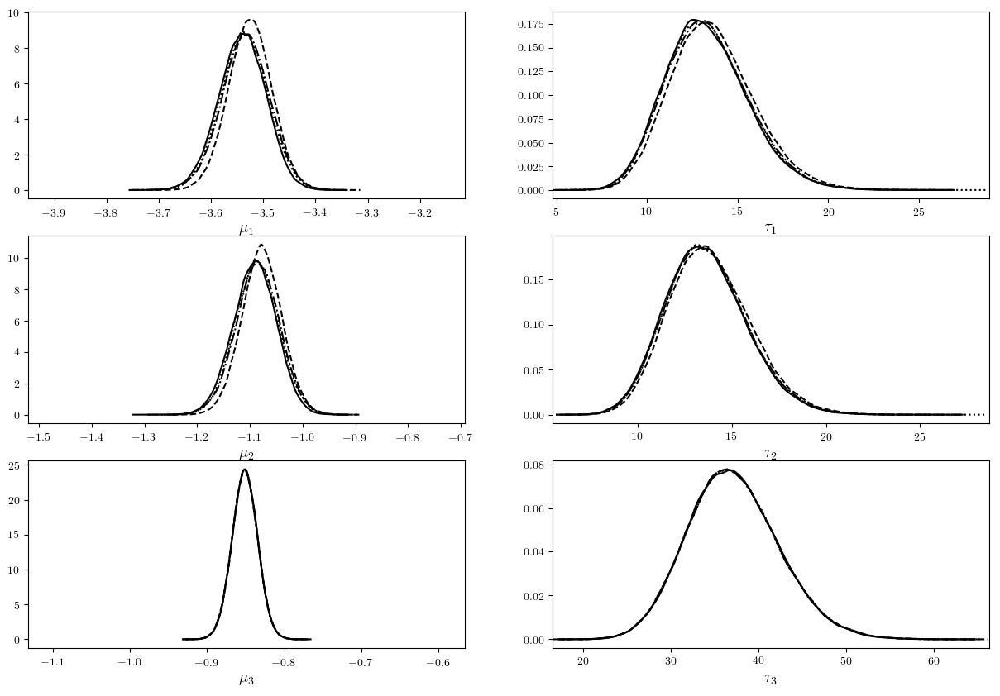

Process(`pdftops -eps figures/ou_marginal_post_eta_new.pdf figures/ou_marginal_post_eta_new.eps`, ProcessExited(0))

In [48]:

prior_grid_tau = LinRange(0,8,100)
prior_grid_tau2 = LinRange(0,20,100)

prior_tau1 = pdf.(Gamma(prior_parameters_η[1,3],1/prior_parameters_η[1,4]),prior_grid_tau)
prior_tau2 = pdf.(Gamma(prior_parameters_η[2,3],1/prior_parameters_η[2,4]),prior_grid_tau2)
prior_tau3 = pdf.(Gamma(prior_parameters_η[3,3],1/prior_parameters_η[3,4]),prior_grid_tau)

prior_grid_mu1 = prior_grid = LinRange(-6, -1,100)
prior_grid_mu2 = prior_grid = LinRange(-2,0,100)
prior_grid_mu3 = prior_grid = LinRange(-3,0,100)


tau1 = prior_parameters_η[1,3]/prior_parameters_η[1,4]
tau2 = prior_parameters_η[2,3]/prior_parameters_η[2,4]
tau3 = prior_parameters_η[3,3]/prior_parameters_η[3,4]

prior_mu1 = pdf.(Normal(prior_parameters_η[1,1],sqrt(1/(prior_parameters_η[1,2]*tau1))),prior_grid_mu1)
prior_mu2 = pdf.(Normal(prior_parameters_η[2,1],sqrt(1/(prior_parameters_η[2,2]*tau2))),prior_grid_mu2)
prior_mu3 = pdf.(Normal(prior_parameters_η[3,1],sqrt(1/(prior_parameters_η[3,2]*tau3))),prior_grid_mu3)

posterior_kalman1 = kde(chain_η_kalman[1,burn_in:end])
#posterior_bootstrap1 = kde(chain_η_cpmmh_bootstrap[1,burn_in:end])
#posterior_bridge1 = kde(chain_η_cpmmh_bridge[1,burn_in:end])
posterior_pmmh1 = kde(chain_η_pmmh[1,burn_in:end])
posterior_cpmmh1 = kde(chain_η_cpmmh[1,burn_in:end])
posterior_cpmmh109 = kde(chain_η_cpmmh09[1,burn_in:end])

posterior_kalman2 = kde(chain_η_kalman[2,burn_in:end])
#posterior_bootstrap2 = kde(chain_η_cpmmh_bootstrap[2,burn_in:end])
#posterior_bridge2 = kde(chain_η_cpmmh_bridge[2,burn_in:end])
posterior_pmmh2 = kde(chain_η_pmmh[2,burn_in:end])
posterior_cpmmh2 = kde(chain_η_cpmmh[2,burn_in:end])
posterior_cpmmh209 = kde(chain_η_cpmmh09[2,burn_in:end])


posterior_kalman3 = kde(chain_η_kalman[3,burn_in:end])
#posterior_bootstrap3 = kde(chain_η_cpmmh_bootstrap[3,burn_in:end])
#posterior_bridge3 = kde(chain_η_cpmmh_bridge[3,burn_in:end])
posterior_pmmh3 = kde(chain_η_pmmh[3,burn_in:end])
posterior_cpmmh3 = kde(chain_η_cpmmh[3,burn_in:end])
posterior_cpmmh309 = kde(chain_η_cpmmh09[3,burn_in:end])

posterior_kalman4 = kde(chain_η_kalman[4,burn_in:end])
#posterior_bootstrap4 = kde(chain_η_cpmmh_bootstrap[4,burn_in:end])
#posterior_bridge4 = kde(chain_η_cpmmh_bridge[4,burn_in:end])
posterior_pmmh4 = kde(chain_η_pmmh[4,burn_in:end])
posterior_cpmmh4 = kde(chain_η_cpmmh[4,burn_in:end])
posterior_cpmmh409 = kde(chain_η_cpmmh09[4,burn_in:end])

posterior_kalman5 = kde(chain_η_kalman[5,burn_in:end])
#posterior_bootstrap5 = kde(chain_η_cpmmh_bootstrap[5,burn_in:end])
#posterior_bridge5 = kde(chain_η_cpmmh_bridge[5,burn_in:end])
posterior_pmmh5 = kde(chain_η_pmmh[5,burn_in:end])
posterior_cpmmh5 = kde(chain_η_cpmmh[5,burn_in:end])
posterior_cpmmh509 = kde(chain_η_cpmmh09[5,burn_in:end])

posterior_kalman6 = kde(chain_η_kalman[6,burn_in:end])
#posterior_bootstrap6 = kde(chain_η_cpmmh_bootstrap[6,burn_in:end])
#posterior_bridge6 = kde(chain_η_cpmmh_bridge[6,burn_in:end])
posterior_pmmh6 = kde(chain_η_pmmh[6,burn_in:end])
posterior_cpmmh6 = kde(chain_η_cpmmh[6,burn_in:end])
posterior_cpmmh609 = kde(chain_η_cpmmh09[6,burn_in:end])

PyPlot.figure(figsize=(15,10))

ax1 = PyPlot.subplot(3,2,1)
#PyPlot.plot(prior_grid_mu1,prior_mu1, "k")
PyPlot.plot(posterior_kalman1.x,posterior_kalman1.density, "k")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh1.x,posterior_pmmh1.density, "k--")
PyPlot.plot(posterior_cpmmh1.x,posterior_cpmmh1.density, "k:")
PyPlot.plot(posterior_cpmmh109.x,posterior_cpmmh109.density, "k-.")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman1.x);
             minimum(posterior_pmmh1.x);
             minimum(posterior_cpmmh1.x)])-0.2, maximum([maximum(posterior_kalman1.x);
                                                         maximum(posterior_pmmh1.x);
                                                         maximum(posterior_cpmmh1.x)])+0.2));
PyPlot.xlabel(L"\mu_1",fontsize=14)


ax1 = PyPlot.subplot(3,2,3)
#PyPlot.plot(prior_grid_mu2,prior_mu2, "k")
PyPlot.plot(posterior_kalman2.x,posterior_kalman2.density, "k")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh2.x,posterior_pmmh2.density, "k--")
PyPlot.plot(posterior_cpmmh2.x,posterior_cpmmh2.density, "k:")
PyPlot.plot(posterior_cpmmh209.x,posterior_cpmmh209.density, "k-.")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman2.x);
             minimum(posterior_pmmh2.x);
             minimum(posterior_cpmmh2.x)])-0.2, maximum([maximum(posterior_kalman2.x);
                                                         maximum(posterior_pmmh2.x);
                                                         maximum(posterior_cpmmh2.x)])+0.2));
PyPlot.xlabel(L"\mu_2",fontsize=14)



ax1 = PyPlot.subplot(3,2,5)
#PyPlot.plot(prior_grid_mu3,prior_mu3, "g")
PyPlot.plot(posterior_kalman3.x,posterior_kalman3.density, "k")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh3.x,posterior_pmmh3.density, "k--")
PyPlot.plot(posterior_cpmmh3.x,posterior_cpmmh3.density, "k:")
PyPlot.plot(posterior_cpmmh309.x,posterior_cpmmh309.density, "k-.")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman3.x);
             minimum(posterior_pmmh3.x);
             minimum(posterior_cpmmh3.x)])-0.2, maximum([maximum(posterior_kalman3.x);
                                                         maximum(posterior_pmmh3.x);
                                                         maximum(posterior_cpmmh3.x)])+0.2));
PyPlot.xlabel(L"\mu_3",fontsize=14)


ax1 = PyPlot.subplot(3,2,2)
#PyPlot.plot(prior_grid_tau,prior_tau1, "k")
PyPlot.plot(posterior_kalman4.x,posterior_kalman4.density, "k")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh4.x,posterior_pmmh4.density, "k--")
PyPlot.plot(posterior_cpmmh4.x,posterior_cpmmh4.density, "k:")
PyPlot.plot(posterior_cpmmh409.x,posterior_cpmmh409.density, "k-.")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman4.x);
             minimum(posterior_pmmh4.x);
             minimum(posterior_cpmmh4.x)])-0.2, maximum([maximum(posterior_kalman4.x);
                                                         maximum(posterior_pmmh4.x);
                                                         maximum(posterior_cpmmh4.x)])+0.2));
PyPlot.xlabel(L"\tau_1",fontsize=14)


ax1 = PyPlot.subplot(3,2,4)
#PyPlot.plot(prior_grid_tau2,prior_tau2, "k")
PyPlot.plot(posterior_kalman5.x,posterior_kalman5.density, "k")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh5.x,posterior_pmmh5.density, "k--")
PyPlot.plot(posterior_cpmmh5.x,posterior_cpmmh5.density, "k:")
PyPlot.plot(posterior_cpmmh509.x,posterior_cpmmh509.density, "k-.")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman5.x);
             minimum(posterior_pmmh5.x);
             minimum(posterior_cpmmh5.x)])-0.2, maximum([maximum(posterior_kalman5.x);
                                                         maximum(posterior_pmmh5.x);
                                                         maximum(posterior_cpmmh5.x)])+0.2));
PyPlot.xlabel(L"\tau_2",fontsize=14)
    

ax1 = PyPlot.subplot(3,2,6)
#PyPlot.plot(prior_grid_tau,prior_tau3, "k")
PyPlot.plot(posterior_kalman6.x,posterior_kalman6.density, "k")        
#PyPlot.plot(posterior_bootstrap1.x,posterior_bootstrap1.density, "c")
#PyPlot.plot(posterior_bridge1.x,posterior_bridge1.density, "c--")
PyPlot.plot(posterior_pmmh6.x,posterior_pmmh6.density, "k--")
PyPlot.plot(posterior_cpmmh6.x,posterior_cpmmh6.density, "k:")
PyPlot.plot(posterior_cpmmh609.x,posterior_cpmmh609.density, "k-.")

#PyPlot.plot(posterior_bridge09991.x,posterior_bridge09991.density, "k-.")
PyPlot.xlim((minimum([minimum(posterior_kalman6.x);
             minimum(posterior_pmmh6.x);
             minimum(posterior_cpmmh6.x)])-0.2, maximum([maximum(posterior_kalman6.x);
                                                         maximum(posterior_pmmh6.x);
                                                         maximum(posterior_cpmmh6.x)])+0.2));
PyPlot.xlabel(L"\tau_3",fontsize=14);


if save_plots
    PyPlot.savefig("figures/ou_marginal_post_eta_new.pdf", format="pdf", dpi=1000)
    run(`pdftops -eps figures/ou_marginal_post_eta_new.pdf figures/ou_marginal_post_eta_new.eps`)
end

Log normal distribution calc 

In [52]:
mu_log_lambda_kalman = mean(chain_η_kalman[1,burn_in:end])
var_log_lambda_kalman = mean(chain_η_kalman[4,burn_in:end].^(-1))

mu_lambda_kalman = exp(mu_log_lambda_kalman + var_log_lambda_kalman/2)
std_lambda_kalman = sqrt((exp(var_log_lambda_kalman) - 1) *exp(2*mu_log_lambda_kalman + var_log_lambda_kalman))

println(round(mu_lambda_kalman, digits=3))
println(round(std_lambda_kalman, digits=3))


mu_log_v_kalman = mean(chain_η_kalman[2,burn_in:end])
var_log_v_kalman = mean(chain_η_kalman[5,burn_in:end].^(-1))

mu_v_kalman = exp(mu_log_v_kalman + var_log_v_kalman/2)
std_v_kalman = sqrt((exp(var_log_v_kalman) - 1) *exp(2*mu_log_v_kalman + var_log_v_kalman))

println(round(mu_v_kalman, digits=3))
println(round(std_v_kalman, digits=3))


mu_log_sigma_kalman = mean(chain_η_kalman[3,burn_in:end])
var_log_sigma_kalman = mean(chain_η_kalman[6,burn_in:end].^(-1))

mu_sigma_kalman = exp(mu_log_sigma_kalman + var_log_sigma_kalman/2)
std_sigma_kalman = sqrt((exp(var_log_sigma_kalman) - 1) *exp(2*mu_log_sigma_kalman + var_log_sigma_kalman))

println(round(mu_sigma_kalman, digits=3))
println(round(std_sigma_kalman, digits=3))

0.03
0.009
0.349
0.098
0.433
0.072


In [51]:
round(mu_sigma_kalman,digits=3)

0.433